### Import Neccesary Libraries

In [1]:
import numpy as np
import pandas as pd
import warnings
import scipy.stats as stats
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go


In [2]:
df = pd.read_excel(r'C:\Users\ranam\Downloads\Data_Train.xlsx')
df

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302
...,...,...,...,...,...,...,...,...,...,...,...
10678,Air Asia,9/04/2019,Kolkata,Banglore,CCU → BLR,19:55,22:25,2h 30m,non-stop,No info,4107
10679,Air India,27/04/2019,Kolkata,Banglore,CCU → BLR,20:45,23:20,2h 35m,non-stop,No info,4145
10680,Jet Airways,27/04/2019,Banglore,Delhi,BLR → DEL,08:20,11:20,3h,non-stop,No info,7229
10681,Vistara,01/03/2019,Banglore,New Delhi,BLR → DEL,11:30,14:10,2h 40m,non-stop,No info,12648


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10683 non-null  object
 1   Date_of_Journey  10683 non-null  object
 2   Source           10683 non-null  object
 3   Destination      10683 non-null  object
 4   Route            10682 non-null  object
 5   Dep_Time         10683 non-null  object
 6   Arrival_Time     10683 non-null  object
 7   Duration         10683 non-null  object
 8   Total_Stops      10682 non-null  object
 9   Additional_Info  10683 non-null  object
 10  Price            10683 non-null  int64 
dtypes: int64(1), object(10)
memory usage: 918.2+ KB


In [4]:
df.describe()

,Price
count,10683.000000
mean,9087.064121
std,4611.359167
min,1759.000000
25%,5277.000000
50%,8372.000000
75%,12373.000000
max,79512.000000


In [5]:
df.describe(include= 'O')

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info
count,10683,10683,10683,10683,10682,10683,10683,10683,10682,10683
unique,12,44,5,6,128,222,1343,368,5,10
top,Jet Airways,18/05/2019,Delhi,Cochin,DEL → BOM → COK,18:55,19:00,2h 50m,1 stop,No info
freq,3849,504,4537,4537,2376,233,423,550,5625,8345


 ### Data Cleaning

In [6]:
# Check duplicates
df.duplicated().sum()

220

In [7]:
df.drop_duplicates(inplace= True)

In [8]:
# Check duplicates
df.duplicated().sum()


0

In [9]:
# After removing any rows from data we should reset index
df.reset_index(inplace= True, drop= True)

In [10]:
df.isna().sum()

Airline            0
Date_of_Journey    0
Source             0
Destination        0
Route              1
Dep_Time           0
Arrival_Time       0
Duration           0
Total_Stops        1
Additional_Info    0
Price              0
dtype: int64

In [11]:
# Check missing values by percentage
df.isna().mean() * 100

Airline            0.000000
Date_of_Journey    0.000000
Source             0.000000
Destination        0.000000
Route              0.009557
Dep_Time           0.000000
Arrival_Time       0.000000
Duration           0.000000
Total_Stops        0.009557
Additional_Info    0.000000
Price              0.000000
dtype: float64

In [12]:
df.dropna(subset=['Route', 'Total_Stops'], inplace=True)


In [13]:
df.reset_index(inplace= True, drop= True)

In [14]:
df.isna().mean() * 100


Airline            0.0
Date_of_Journey    0.0
Source             0.0
Destination        0.0
Route              0.0
Dep_Time           0.0
Arrival_Time       0.0
Duration           0.0
Total_Stops        0.0
Additional_Info    0.0
Price              0.0
dtype: float64

## Features engineering

In [15]:
# i will Convert date to int not to data to datetime for ML
df['Date']=df['Date_of_Journey'].str.split('/').str[0]
df['Month']=df['Date_of_Journey'].str.split('/').str[1]


In [16]:
df['Date']=df['Date'].astype(int)
df['Month']=df['Month'].astype(int)

In [17]:
df.drop('Date_of_Journey', axis=1, inplace=True)

In [18]:
df.head()

,Airline,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,Date,Month
0,IndiGo,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897,24,3
1,Air India,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662,1,5
2,Jet Airways,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882,9,6
3,IndiGo,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218,12,5
4,IndiGo,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302,1,3


In [19]:
df['Arrival_hours'] = df['Arrival_Time'].str.split(' ').str[0].str.split(':').str[0]
df['Arrival_minutes'] = df['Arrival_Time'].str.split(' ').str[0].str.split(':').str[1]
df.drop('Arrival_Time',axis=1,inplace=True)

In [20]:
df['Arrival_hours'] = df['Arrival_hours'].astype(int)
df['Arrival_minutes'] = df['Arrival_minutes'].astype(int)

In [21]:
df.head()

,Airline,Source,Destination,Route,Dep_Time,Duration,Total_Stops,Additional_Info,Price,Date,Month,Arrival_hours,Arrival_minutes
0,IndiGo,Banglore,New Delhi,BLR → DEL,22:20,2h 50m,non-stop,No info,3897,24,3,1,10
1,Air India,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,7h 25m,2 stops,No info,7662,1,5,13,15
2,Jet Airways,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,19h,2 stops,No info,13882,9,6,4,25
3,IndiGo,Kolkata,Banglore,CCU → NAG → BLR,18:05,5h 25m,1 stop,No info,6218,12,5,23,30
4,IndiGo,Banglore,New Delhi,BLR → NAG → DEL,16:50,4h 45m,1 stop,No info,13302,1,3,21,35


In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10462 entries, 0 to 10461
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10462 non-null  object
 1   Source           10462 non-null  object
 2   Destination      10462 non-null  object
 3   Route            10462 non-null  object
 4   Dep_Time         10462 non-null  object
 5   Duration         10462 non-null  object
 6   Total_Stops      10462 non-null  object
 7   Additional_Info  10462 non-null  object
 8   Price            10462 non-null  int64 
 9   Date             10462 non-null  int32 
 10  Month            10462 non-null  int32 
 11  Arrival_hours    10462 non-null  int32 
 12  Arrival_minutes  10462 non-null  int32 
dtypes: int32(4), int64(1), object(8)
memory usage: 899.2+ KB


In [23]:
df['Dept_hour']=df['Dep_Time'].str.split(':').str[0]
df['Dept_min']=df['Dep_Time'].str.split(':').str[1]

In [24]:
df['Dept_hour']=df['Dept_hour'].astype(int)
df['Dept_min']=df['Dept_min'].astype(int)

In [25]:
df.drop('Dep_Time',axis=1,inplace=True)

In [26]:
df.head()

,Airline,Source,Destination,Route,Duration,Total_Stops,Additional_Info,Price,Date,Month,Arrival_hours,Arrival_minutes,Dept_hour,Dept_min
0,IndiGo,Banglore,New Delhi,BLR → DEL,2h 50m,non-stop,No info,3897,24,3,1,10,22,20
1,Air India,Kolkata,Banglore,CCU → IXR → BBI → BLR,7h 25m,2 stops,No info,7662,1,5,13,15,5,50
2,Jet Airways,Delhi,Cochin,DEL → LKO → BOM → COK,19h,2 stops,No info,13882,9,6,4,25,9,25
3,IndiGo,Kolkata,Banglore,CCU → NAG → BLR,5h 25m,1 stop,No info,6218,12,5,23,30,18,5
4,IndiGo,Banglore,New Delhi,BLR → NAG → DEL,4h 45m,1 stop,No info,13302,1,3,21,35,16,50


In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10462 entries, 0 to 10461
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10462 non-null  object
 1   Source           10462 non-null  object
 2   Destination      10462 non-null  object
 3   Route            10462 non-null  object
 4   Duration         10462 non-null  object
 5   Total_Stops      10462 non-null  object
 6   Additional_Info  10462 non-null  object
 7   Price            10462 non-null  int64 
 8   Date             10462 non-null  int32 
 9   Month            10462 non-null  int32 
 10  Arrival_hours    10462 non-null  int32 
 11  Arrival_minutes  10462 non-null  int32 
 12  Dept_hour        10462 non-null  int32 
 13  Dept_min         10462 non-null  int32 
dtypes: int32(6), int64(1), object(7)
memory usage: 899.2+ KB


In [28]:
df['duration_hours'] = df['Duration'].str.split(' ').str[0].str.split('h').str[0]
df['duration_minutes'] = df['Duration'].str.split(' ').str[1].str.split('m').str[0]

In [29]:
df['duration_hours'].unique()

array(['2', '7', '19', '5', '4', '15', '21', '25', '13', '12', '26', '22',
       '23', '20', '10', '6', '11', '8', '16', '3', '27', '1', '14', '9',
       '18', '17', '24', '30', '28', '29', '37', '34', '38', '35', '36',
       '47', '33', '32', '31', '42', '39', '5m', '41', '40'], dtype=object)

In [30]:
df['duration_hours']=df['duration_hours'].replace('5m',5)

In [31]:
df['duration_minutes'].unique()


array(['50', '25', nan, '45', '30', '5', '15', '35', '10', '20', '55',
       '40'], dtype=object)

In [32]:
df['duration_minutes']=df['duration_minutes'].replace(np.nan,0)


In [33]:
df['duration_hours']=df['duration_hours'].astype(int)
df['duration_minutes']=df['duration_minutes'].astype(int)

In [34]:
df['Total_Duration_time_in_minutes'] = ((60 * df['duration_hours']) + df['duration_minutes'])

In [35]:
df.drop(['Duration','duration_hours','duration_minutes'],axis = 1,inplace = True)


In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10462 entries, 0 to 10461
Data columns (total 14 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   Airline                         10462 non-null  object
 1   Source                          10462 non-null  object
 2   Destination                     10462 non-null  object
 3   Route                           10462 non-null  object
 4   Total_Stops                     10462 non-null  object
 5   Additional_Info                 10462 non-null  object
 6   Price                           10462 non-null  int64 
 7   Date                            10462 non-null  int32 
 8   Month                           10462 non-null  int32 
 9   Arrival_hours                   10462 non-null  int32 
 10  Arrival_minutes                 10462 non-null  int32 
 11  Dept_hour                       10462 non-null  int32 
 12  Dept_min                        10462 non-null

In [37]:
df.head()

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,Date,Month,Arrival_hours,Arrival_minutes,Dept_hour,Dept_min,Total_Duration_time_in_minutes
0,IndiGo,Banglore,New Delhi,BLR → DEL,non-stop,No info,3897,24,3,1,10,22,20,170
1,Air India,Kolkata,Banglore,CCU → IXR → BBI → BLR,2 stops,No info,7662,1,5,13,15,5,50,445
2,Jet Airways,Delhi,Cochin,DEL → LKO → BOM → COK,2 stops,No info,13882,9,6,4,25,9,25,1140
3,IndiGo,Kolkata,Banglore,CCU → NAG → BLR,1 stop,No info,6218,12,5,23,30,18,5,325
4,IndiGo,Banglore,New Delhi,BLR → NAG → DEL,1 stop,No info,13302,1,3,21,35,16,50,285


In [38]:
df["Total_Stops"].value_counts()

Total_Stops
1 stop      5625
non-stop    3475
2 stops     1318
3 stops       43
4 stops        1
Name: count, dtype: int64

In [39]:
df.replace({"non-stop": 0, "1 stop": 1, "2 stops": 2, "3 stops": 3, "4 stops": 4}, inplace = True)

C:\Users\ranam\AppData\Local\Temp\ipykernel_16328\3142719428.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.replace({"non-stop": 0, "1 stop": 1, "2 stops": 2, "3 stops": 3, "4 stops": 4}, inplace = True)


In [40]:
df["Total_Stops"].value_counts()


Total_Stops
1    5625
0    3475
2    1318
3      43
4       1
Name: count, dtype: int64

### Univariate Analysis for Cleaning¶

In [41]:
# Drop unneccesary columns
df.drop('Route', axis= 1, inplace= True)


In [42]:
# After removing any column from data, make a quick check if there is any duplicates
df.duplicated().sum()

2

In [43]:
df.drop_duplicates(inplace= True)

In [44]:
df.duplicated().sum()

0

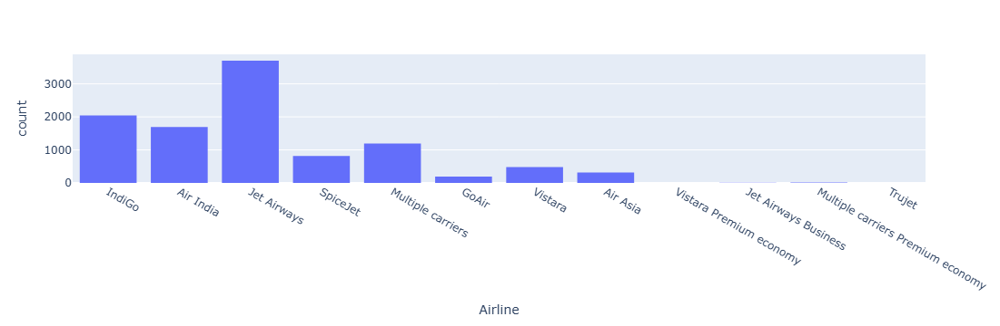

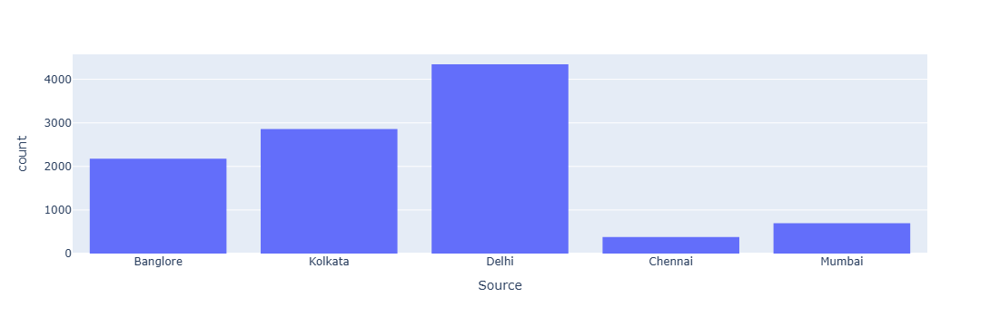

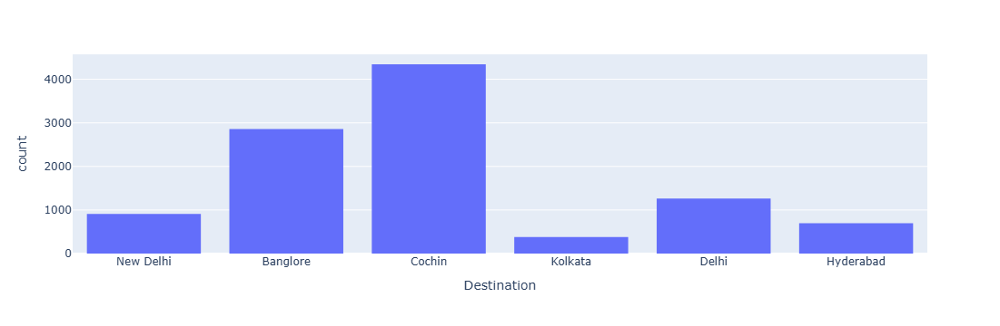

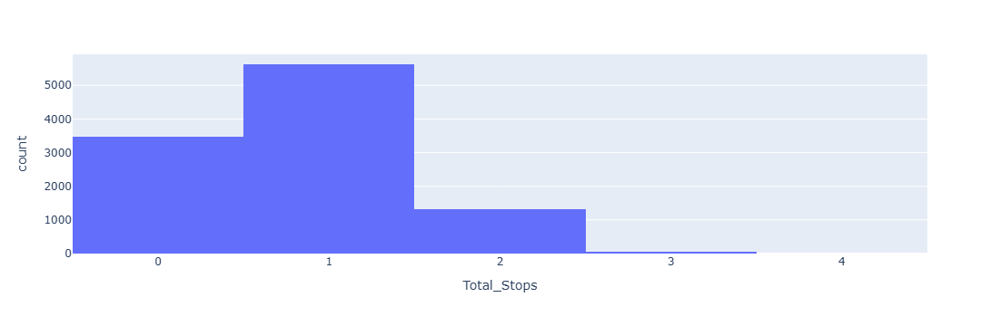

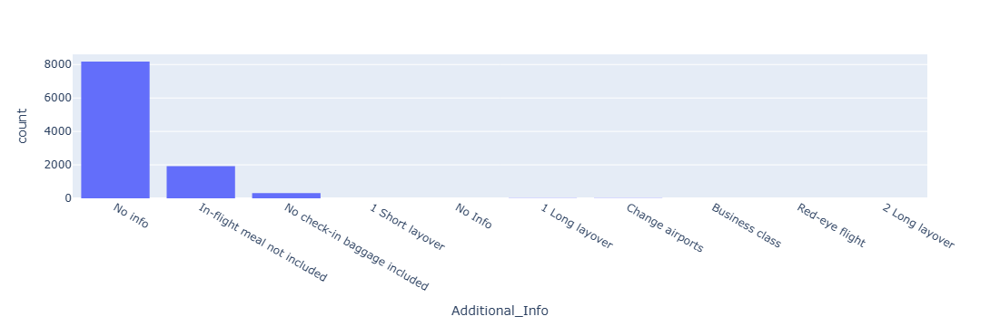

...

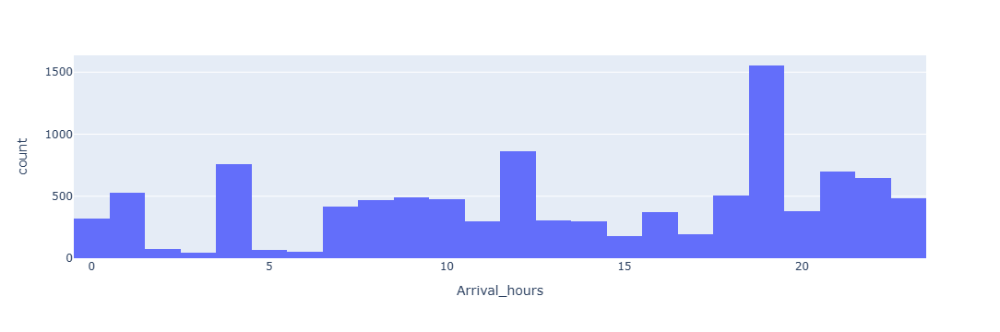

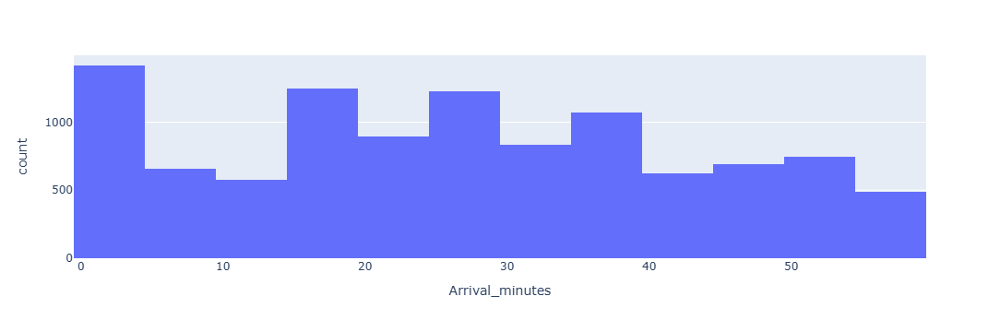

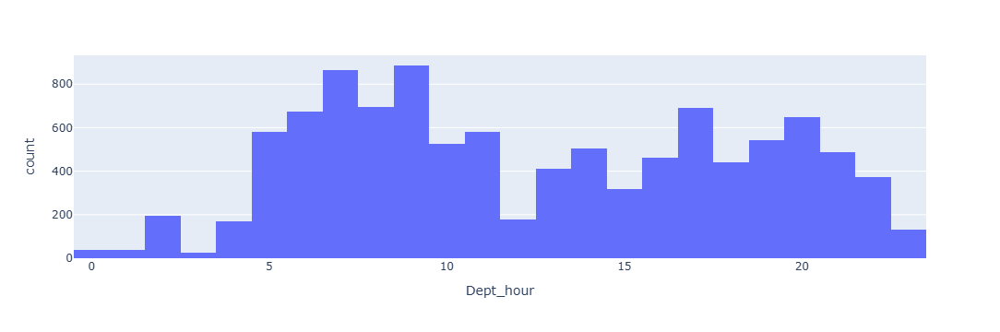

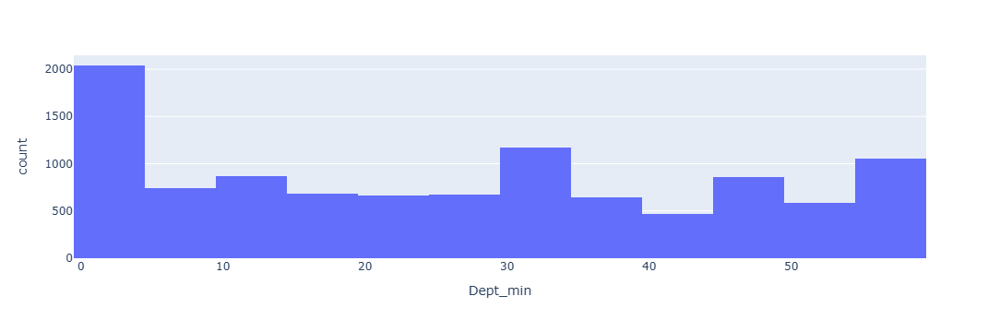

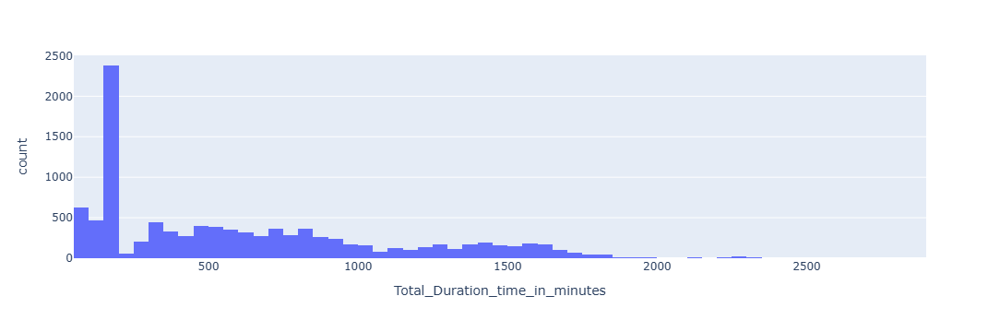

In [45]:
for col in df.columns:
    fig = px.histogram(df, x= col)
    fig.show()

In [46]:
df.columns

Index(['Airline', 'Source', 'Destination', 'Total_Stops', 'Additional_Info',
       'Price', 'Date', 'Month', 'Arrival_hours', 'Arrival_minutes',
       'Dept_hour', 'Dept_min', 'Total_Duration_time_in_minutes'],
      dtype='object')

### Univariate Analysis

#### What is the frequency distribution of flights for each airline?

In [47]:
airline_counts = df['Airline'].value_counts()

C:\Users\ranam\AppData\Local\Temp\ipykernel_16328\717458700.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




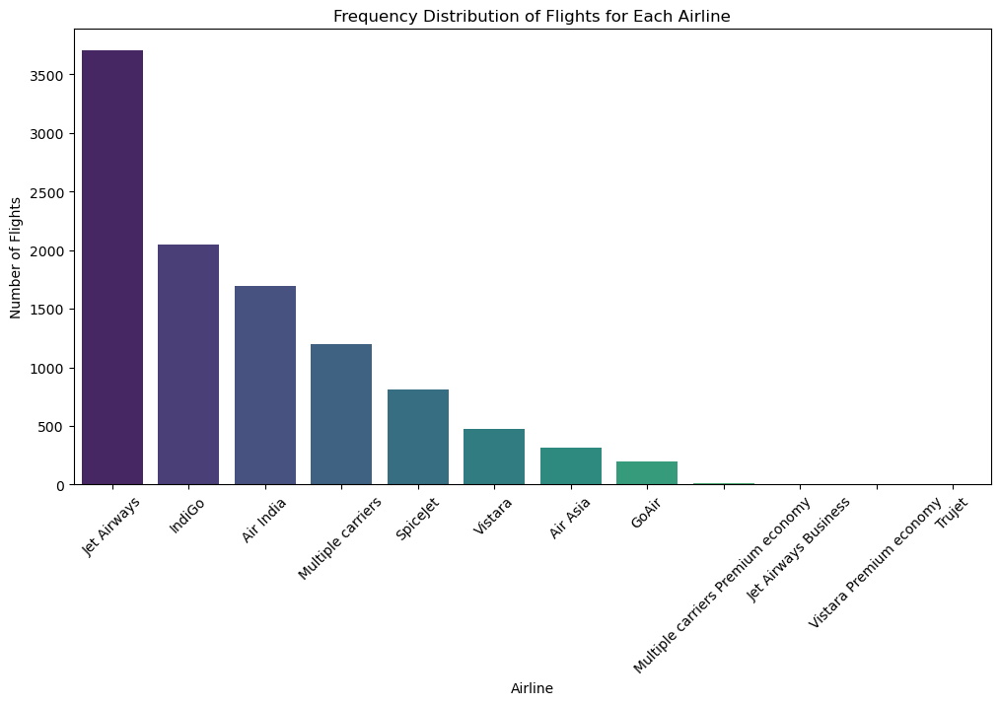

In [48]:
plt.figure(figsize=(12, 6))
sns.barplot(x=airline_counts.index, y=airline_counts.values, palette='viridis')
plt.title('Frequency Distribution of Flights for Each Airline')
plt.xlabel('Airline')
plt.ylabel('Number of Flights')
plt.xticks(rotation=45)
plt.show()

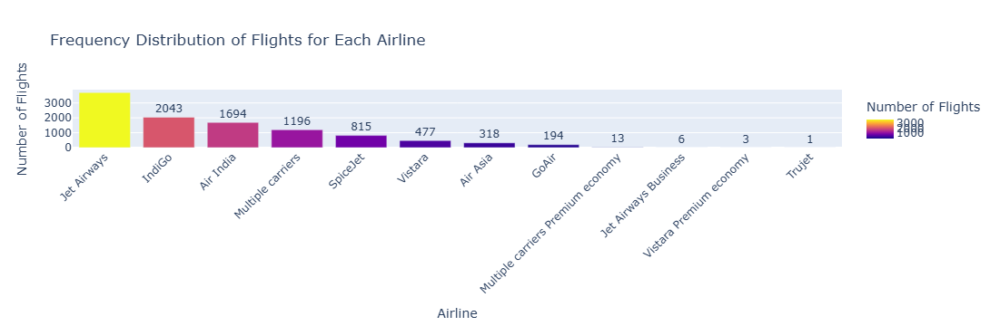

In [49]:
airline_counts = df['Airline'].value_counts().reset_index()
airline_counts.columns = ['Airline', 'Number of Flights']

fig = px.bar(airline_counts, 
             x='Airline', 
             y='Number of Flights', 
             title='Frequency Distribution of Flights for Each Airline',
             color='Number of Flights',
             text='Number of Flights')


fig.update_traces(texttemplate='%{text}', textposition='outside')
fig.update_layout(xaxis_title='Airline',
                  yaxis_title='Number of Flights',
                  xaxis_tickangle=-45)


fig.show()

### Which airline has the highest number of flights?

In [50]:
highest_airline = df['Airline'].mode()[0]  # Get the most common airline
highest_flights = df['Airline'].value_counts().max()  # Get the maximum flight count
print(f"The airline with the highest number of flights is '{highest_airline}' with {highest_flights} flights.")




The airline with the highest number of flights is 'Jet Airways' with 3700 flights.


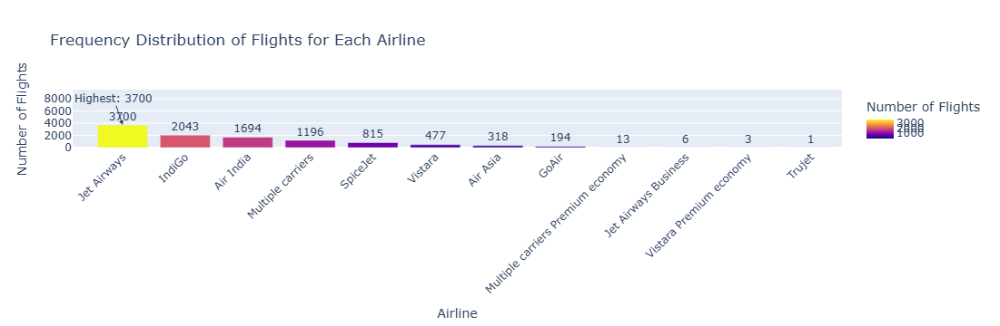

In [51]:
# Count the number of flights for each airline
airline_counts = df['Airline'].value_counts().reset_index()
airline_counts.columns = ['Airline', 'Number of Flights']

# Identify the airline with the highest number of flights
highest_airline = airline_counts.loc[airline_counts['Number of Flights'].idxmax()]

# Create an interactive bar chart
fig = px.bar(airline_counts,
             x='Airline',
             y='Number of Flights',
             title='Frequency Distribution of Flights for Each Airline',
             color='Number of Flights',
             text='Number of Flights')

# Highlight the airline with the highest number of flights
fig.add_annotation(x=highest_airline['Airline'], 
                   y=highest_airline['Number of Flights'],
                   text=f"Highest: {highest_airline['Number of Flights']}",
                   showarrow=True, 
                   arrowhead=2)

# Update layout for better aesthetics
fig.update_traces(texttemplate='%{text}', textposition='outside')
fig.update_layout(xaxis_title='Airline',
                  yaxis_title='Number of Flights',
                  xaxis_tickangle=-45)

# Show the figure
fig.show()

### How many flights are departing from each source city? 

C:\Users\ranam\AppData\Local\Temp\ipykernel_16328\4025714579.py:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




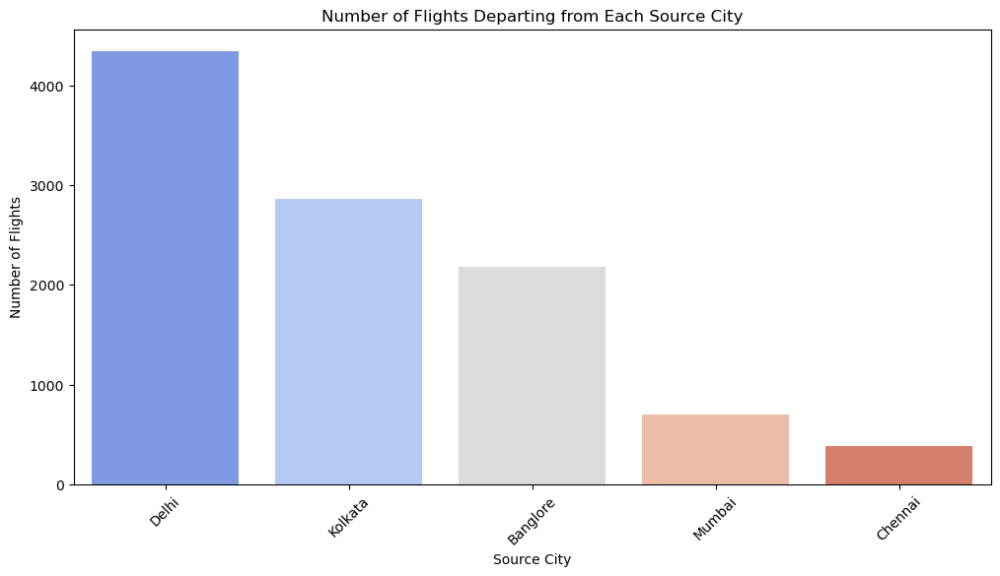

In [52]:
source_counts = df['Source'].value_counts().reset_index()
source_counts.columns = ['Source', 'Number of Flights']

plt.figure(figsize=(12, 6))
sns.barplot(data=source_counts, x='Source', y='Number of Flights', palette='coolwarm')

plt.title('Number of Flights Departing from Each Source City')
plt.xlabel('Source City')
plt.ylabel('Number of Flights')
plt.xticks(rotation=45)

plt.show()

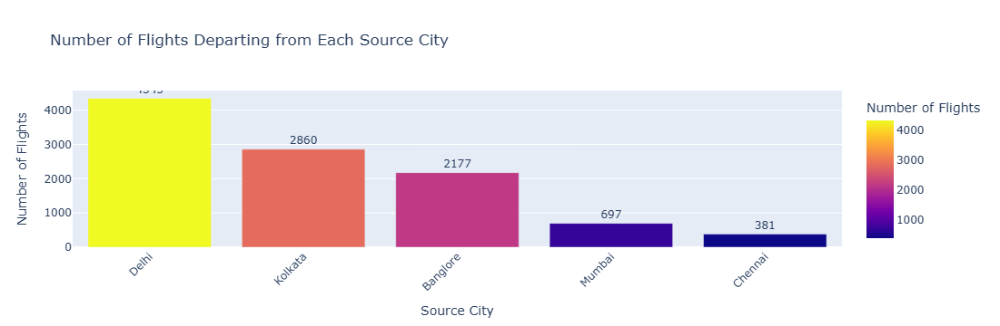

In [53]:
fig = px.bar(source_counts,
             x='Source',
             y='Number of Flights',
             title='Number of Flights Departing from Each Source City',
             color='Number of Flights',
             text='Number of Flights')

# Update layout for better aesthetics
fig.update_traces(texttemplate='%{text}', textposition='outside')
fig.update_layout(xaxis_title='Source City',
                  yaxis_title='Number of Flights',
                  xaxis_tickangle=-45)

# Show the figure
fig.show()

### #What is the most common source city for flights in the dataset? 

In [54]:
most_common_source = df['Source'].mode()[0]  # Get the most frequent source city
count = df['Source'].value_counts().max()    # Get the count of that source city

print(f"The most common source city for flights is '{most_common_source}' with {count} flights.")

The most common source city for flights is 'Delhi' with 4345 flights.


### How many flights are arriving at each destination?

In [55]:
destination_counts = df['Destination'].value_counts().reset_index()
destination_counts.columns = ['Destination', 'Number of Flights']

print(destination_counts)

  Destination  Number of Flights
0      Cochin               4345
1    Banglore               2860
2       Delhi               1265
3   New Delhi                912
4   Hyderabad                697
5     Kolkata                381


### Which destination has the highest number of flights?

In [56]:
destination_counts = df['Destination'].value_counts()

# Identify the destination with the highest number of flights
highest_destination = destination_counts.idxmax()  # Get the destination name
highest_flights = destination_counts.max()         # Get the count of flights

print(f"The destination with the highest number of flights is '{highest_destination}' with {highest_flights} flights.")

The destination with the highest number of flights is 'Cochin' with 4345 flights.


### What is the distribution of flights based on the number of stops (e.g., non-stop, 1 stop, etc.)?

In [57]:
stops_distribution = df['Total_Stops'].value_counts().reset_index()
stops_distribution.columns = ['Total Stops', 'Number of Flights']
print(stops_distribution)

   Total Stops  Number of Flights
0            1               5625
1            0               3473
2            2               1318
3            3                 43
4            4                  1


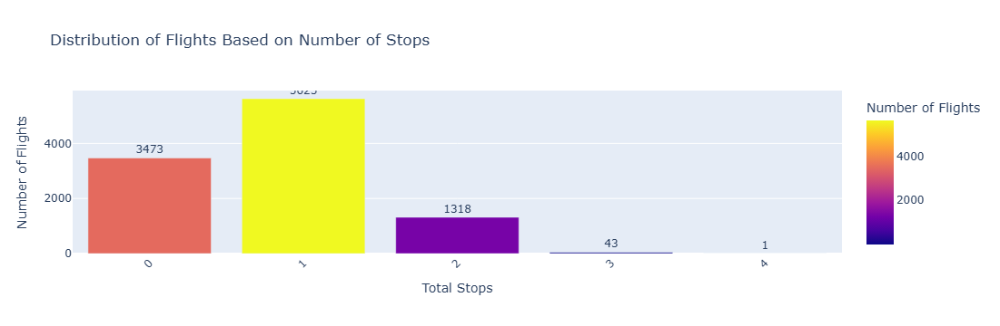

In [58]:
stops_distribution = df['Total_Stops'].value_counts().reset_index()
stops_distribution.columns = ['Total Stops', 'Number of Flights']


fig = px.bar(stops_distribution,
             x='Total Stops',
             y='Number of Flights',
             title='Distribution of Flights Based on Number of Stops',
             color='Number of Flights',
             text='Number of Flights')

# Update layout for better aesthetics
fig.update_traces(texttemplate='%{text}', textposition='outside')
fig.update_layout(xaxis_title='Total Stops',
                  yaxis_title='Number of Flights',
                  xaxis_tickangle=-45)

# Show the figure
fig.show()

### How does the total number of stops affect the frequency of flights?

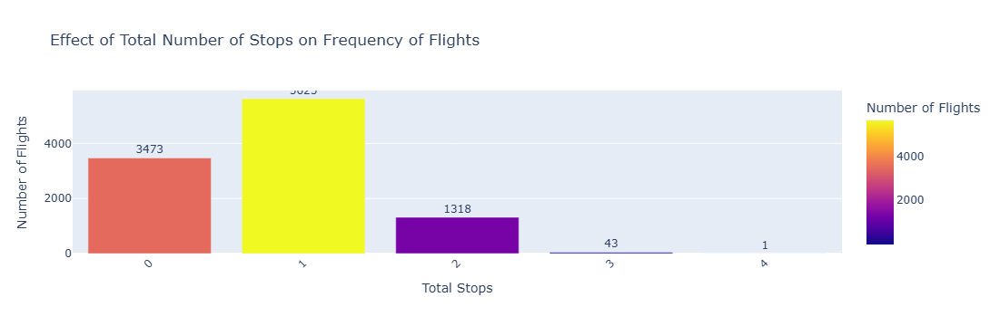

In [59]:
fig = px.bar(stops_distribution,
             x='Total Stops',
             y='Number of Flights',
             title='Effect of Total Number of Stops on Frequency of Flights',
             color='Number of Flights',
             text='Number of Flights')


fig.update_traces(texttemplate='%{text}', textposition='outside')
fig.update_layout(xaxis_title='Total Stops',
                  yaxis_title='Number of Flights',
                  xaxis_tickangle=-45)

# Show the figure
fig.show()

### What are the most common additional info categories provided?

In [60]:
additional_info_counts = df['Additional_Info'].value_counts().reset_index()
additional_info_counts.columns = ['Additional Info', 'Count']

print(additional_info_counts)

                Additional Info  Count
0                       No info   8180
1   In-flight meal not included   1926
2  No check-in baggage included    318
3                1 Long layover     19
4               Change airports      7
5                Business class      4
6                       No Info      3
7               1 Short layover      1
8                Red-eye flight      1
9                2 Long layover      1


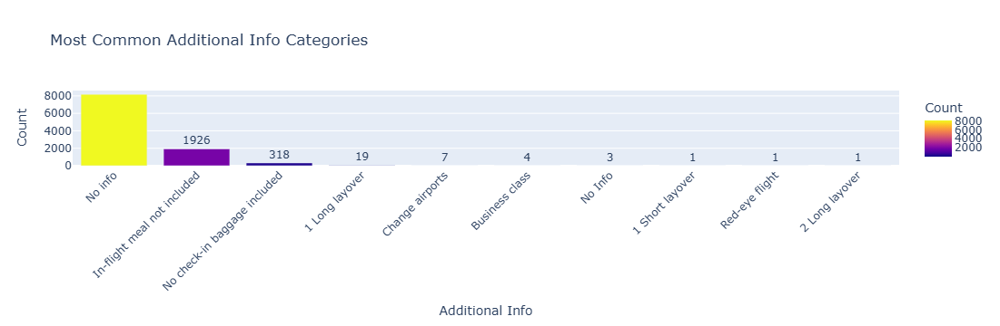

In [61]:
fig = px.bar(additional_info_counts,
             x='Additional Info',
             y='Count',
             title='Most Common Additional Info Categories',
             color='Count',
             text='Count')

# Update layout for better aesthetics
fig.update_traces(texttemplate='%{text}', textposition='outside')
fig.update_layout(xaxis_title='Additional Info',
                  yaxis_title='Count',
                  xaxis_tickangle=-45)


fig.show()

### What is the distribution of flight prices in the dataset?

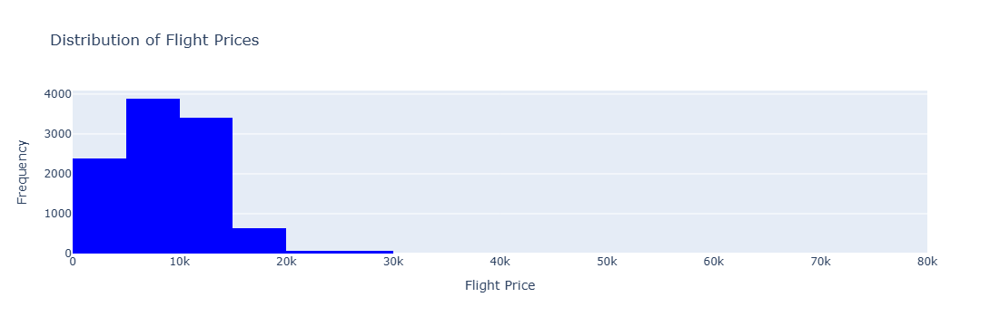

In [62]:
fig = px.histogram(df, 
                   x='Price', 
                   title='Distribution of Flight Prices',
                   nbins=30,  # Number of bins
                   labels={'Price': 'Flight Price'},
                   color_discrete_sequence=['blue'])

# Update layout for better aesthetics
fig.update_layout(xaxis_title='Flight Price',
                  yaxis_title='Frequency')

fig.show()

### What is the mean, median, and range of flight prices

In [63]:
mean_price = df['Price'].mean()
median_price = df['Price'].median()
price_range = df['Price'].max() - df['Price'].min()

print(f"Mean Price: {mean_price:.2f}")
print(f"Median Price: {median_price:.2f}")
print(f"Range of Prices: {price_range:.2f}")


Mean Price: 9027.36
Median Price: 8266.00
Range of Prices: 77753.00


### How many flights are scheduled on each date?

In [64]:
flights_per_date = df['Date'].value_counts().reset_index()
flights_per_date.columns = ['Date', 'Number of Flights']

# Print the result
print(flights_per_date)

   Date  Number of Flights
0     9               1375
1     6               1268
2    27               1092
3    21               1085
4     1               1058
5    24               1021
6    15                967
7    12                946
8     3                834
9    18                814


C:\Users\ranam\AppData\Local\Temp\ipykernel_16328\4045906999.py:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




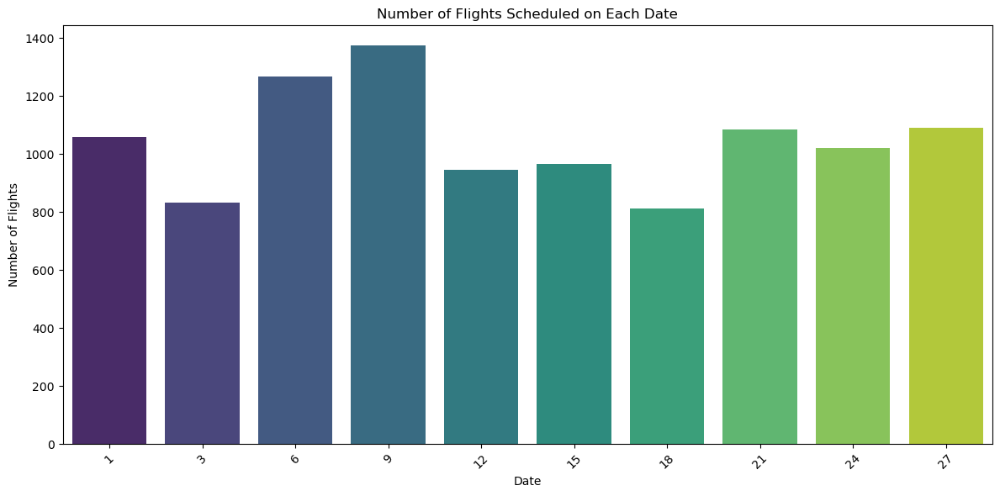

In [65]:
flights_per_date = df['Date'].value_counts().reset_index()
flights_per_date.columns = ['Date', 'Number of Flights']



flights_per_date = flights_per_date.sort_values(by='Date')


plt.figure(figsize=(12, 6))
sns.barplot(data=flights_per_date, x='Date', y='Number of Flights', palette='viridis')

# Update titles and labels
plt.title('Number of Flights Scheduled on Each Date')
plt.xlabel('Date')
plt.ylabel('Number of Flights')
plt.xticks(rotation=45)


plt.tight_layout()  # Adjust layout
plt.show()

### Is there a trend in the number of flights over the observed dates?

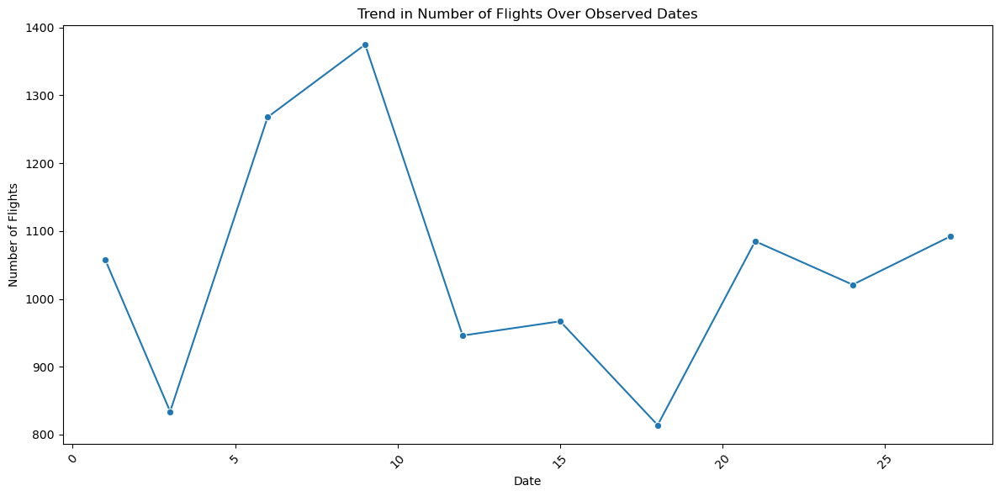

In [66]:
flights_per_date = df['Date'].value_counts().reset_index()
flights_per_date.columns = ['Date', 'Number of Flights']



flights_per_date = flights_per_date.sort_values(by='Date')


plt.figure(figsize=(12, 6))
sns.lineplot(data=flights_per_date, x='Date', y='Number of Flights', marker='o')


plt.title('Trend in Number of Flights Over Observed Dates')
plt.xlabel('Date')
plt.ylabel('Number of Flights')
plt.xticks(rotation=45)


plt.tight_layout()  # Adjust layout
plt.show()

### What is the distribution of flights across different months?

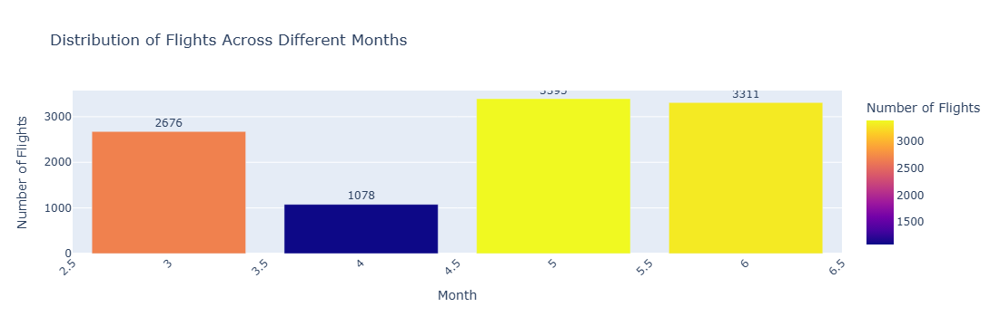

In [67]:

monthly_flights = df['Month'].value_counts().reset_index()
monthly_flights.columns = ['Month', 'Number of Flights']


fig = px.bar(monthly_flights,
             x='Month',
             y='Number of Flights',
             title='Distribution of Flights Across Different Months',
             color='Number of Flights',
             text='Number of Flights')

# Update layout for better aesthetics
fig.update_traces(texttemplate='%{text}', textposition='outside')
fig.update_layout(xaxis_title='Month',
                  yaxis_title='Number of Flights',
                  xaxis_tickangle=-45)

# Show the figure
fig.show()

### Which month has the highest and lowest number of flights

In [68]:
monthly_flights = df['Month'].value_counts().reset_index()
monthly_flights.columns = ['Month', 'Number of Flights']

# Find the month with the highest and lowest number of flights
highest_month = monthly_flights.loc[monthly_flights['Number of Flights'].idxmax()]
lowest_month = monthly_flights.loc[monthly_flights['Number of Flights'].idxmin()]

# Print results
print(f"Month with the highest number of flights: {highest_month['Month']} ({highest_month['Number of Flights']} flights)")
print(f"Month with the lowest number of flights: {lowest_month['Month']} ({lowest_month['Number of Flights']} flights)")

Month with the highest number of flights: 5 (3395 flights)
Month with the lowest number of flights: 4 (1078 flights)


C:\Users\ranam\AppData\Local\Temp\ipykernel_16328\1280012578.py:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




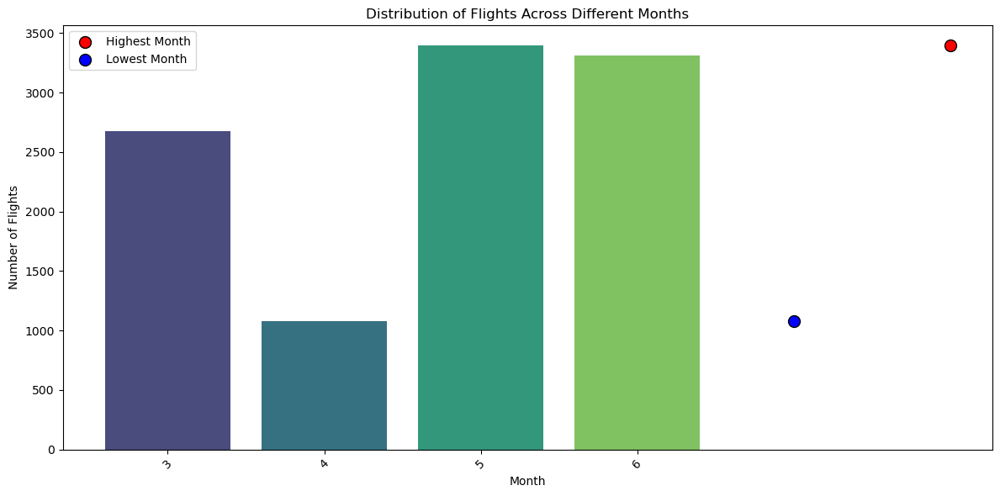

In [69]:
monthly_flights = df['Month'].value_counts().reset_index()
monthly_flights.columns = ['Month', 'Number of Flights']

# Find the month with the highest and lowest number of flights
highest_month = monthly_flights.loc[monthly_flights['Number of Flights'].idxmax()]
lowest_month = monthly_flights.loc[monthly_flights['Number of Flights'].idxmin()]

# Create a bar plot
plt.figure(figsize=(12, 6))
sns.barplot(data=monthly_flights, x='Month', y='Number of Flights', palette='viridis')

# Highlight the highest and lowest months
plt.scatter([highest_month['Month']], [highest_month['Number of Flights']],
            color='red', s=100, label='Highest Month', edgecolor='black')
plt.scatter([lowest_month['Month']], [lowest_month['Number of Flights']],
            color='blue', s=100, label='Lowest Month', edgecolor='black')

# Update titles and labels
plt.title('Distribution of Flights Across Different Months')
plt.xlabel('Month')
plt.ylabel('Number of Flights')
plt.xticks(rotation=45)
plt.legend()

# Show the plot
plt.tight_layout()  # Adjust layout
plt.show()

### Are there certain hours or minutes that are more common for arrivals?

In [70]:
arrival_hour_counts = df['Arrival_hours'].value_counts().sort_index()

# Count the frequency of arrival minutes
arrival_minute_counts = df['Arrival_minutes'].value_counts().sort_index()

# Print results
print("Arrival Hours Frequency:\n", arrival_hour_counts)
print("\nArrival Minutes Frequency:\n", arrival_minute_counts)

Arrival Hours Frequency:
 Arrival_hours
0      321
1      525
2       78
3       47
4      761
5       66
6       51
7      414
8      468
9      489
10     474
11     297
12     861
13     303
14     294
15     182
16     370
17     191
18     509
19    1554
20     377
21     701
22     646
23     481
Name: count, dtype: int64

Arrival Minutes Frequency:
 Arrival_minutes
0     1417
5      658
10     575
15    1245
20     894
25    1224
30     831
35    1070
40     626
45     689
50     744
55     487
Name: count, dtype: int64


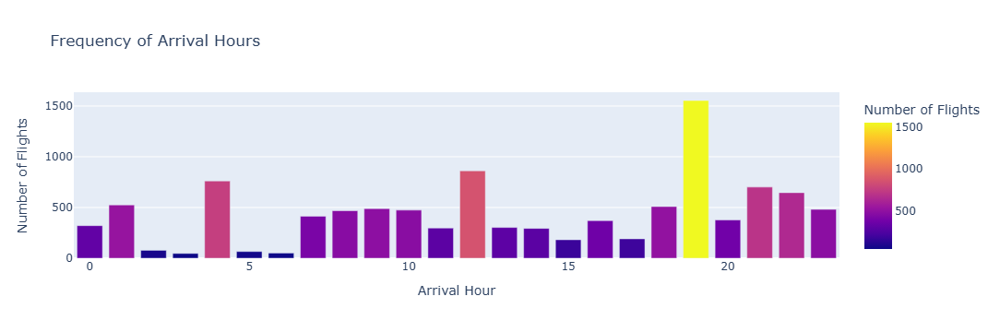

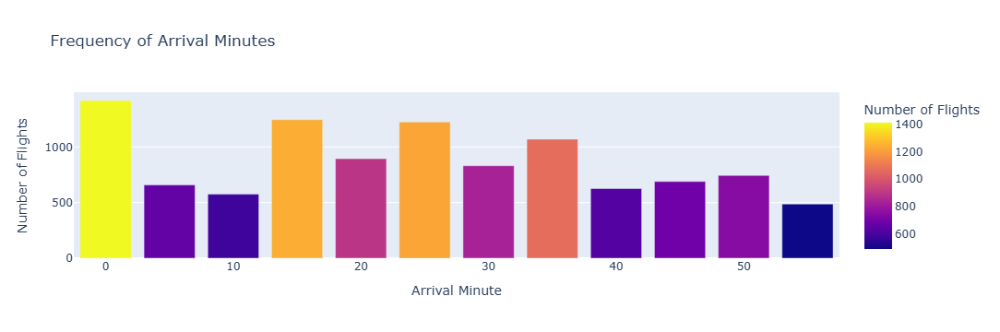

In [71]:
arrival_hour_counts = df['Arrival_hours'].value_counts().reset_index()
arrival_hour_counts.columns = ['Arrival Hour', 'Number of Flights']

# Count the frequency of arrival minutes
arrival_minute_counts = df['Arrival_minutes'].value_counts().reset_index()
arrival_minute_counts.columns = ['Arrival Minute', 'Number of Flights']

# Create an interactive bar chart for Arrival Hours
fig_hour = px.bar(arrival_hour_counts,
                  x='Arrival Hour',
                  y='Number of Flights',
                  title='Frequency of Arrival Hours',
                  labels={'Number of Flights': 'Number of Flights'},
                  color='Number of Flights')

# Create an interactive bar chart for Arrival Minutes
fig_minute = px.bar(arrival_minute_counts,
                    x='Arrival Minute',
                    y='Number of Flights',
                    title='Frequency of Arrival Minutes',
                    labels={'Number of Flights': 'Number of Flights'},
                    color='Number of Flights')

# Show the figures
fig_hour.show()
fig_minute.show()

### What is the distribution of departure times throughout the day?

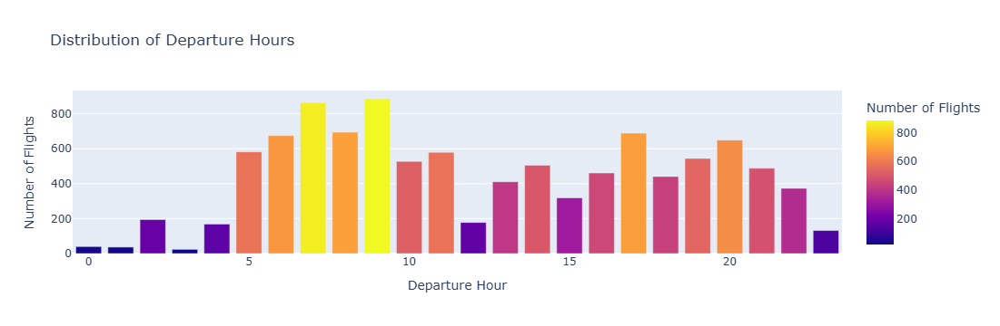

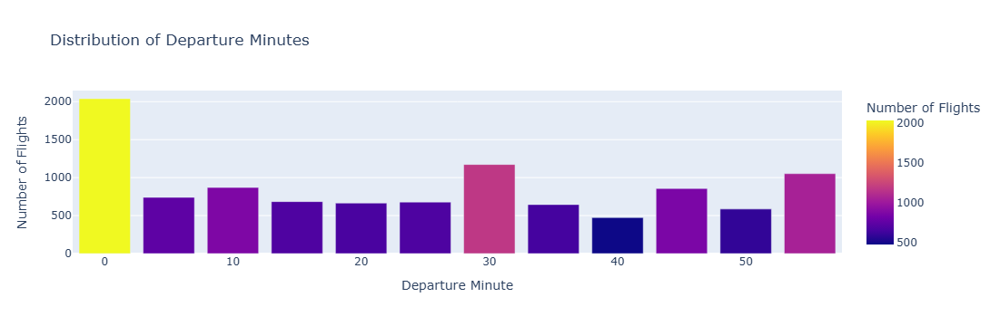

In [72]:
departure_hour_counts = df['Dept_hour'].value_counts().reset_index()
departure_hour_counts.columns = ['Departure Hour', 'Number of Flights']

# Count the frequency of departure minutes
departure_minute_counts = df['Dept_min'].value_counts().reset_index()
departure_minute_counts.columns = ['Departure Minute', 'Number of Flights']

# Step 2: Create an interactive bar chart for Departure Hours
fig_hour = px.bar(departure_hour_counts,
                  x='Departure Hour',
                  y='Number of Flights',
                  title='Distribution of Departure Hours',
                  labels={'Number of Flights': 'Number of Flights'},
                  color='Number of Flights')

# Create an interactive bar chart for Departure Minutes
fig_minute = px.bar(departure_minute_counts,
                    x='Departure Minute',
                    y='Number of Flights',
                    title='Distribution of Departure Minutes',
                    labels={'Number of Flights': 'Number of Flights'},
                    color='Number of Flights')

# Show the figures
fig_hour.show()
fig_minute.show()

### Are there peak departure hours during which most flights leave?

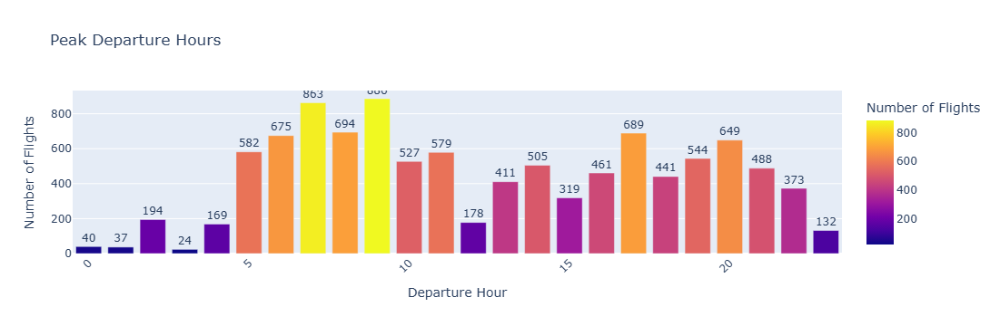

In [73]:
departure_hour_counts = df['Dept_hour'].value_counts().reset_index()
departure_hour_counts.columns = ['Departure Hour', 'Number of Flights']

# Sort by Departure Hour
departure_hour_counts = departure_hour_counts.sort_values(by='Departure Hour')

# Create an interactive bar chart for Departure Hours
fig_hour = px.bar(departure_hour_counts,
                  x='Departure Hour',
                  y='Number of Flights',
                  title='Peak Departure Hours',
                  labels={'Number of Flights': 'Number of Flights'},
                  color='Number of Flights',
                  text='Number of Flights')

# Update layout for better aesthetics
fig_hour.update_traces(texttemplate='%{text}', textposition='outside')
fig_hour.update_layout(xaxis_title='Departure Hour',
                       yaxis_title='Number of Flights',
                       xaxis_tickangle=-45)

# Show the figure
fig_hour.show()

### What is the distribution of flight durations?

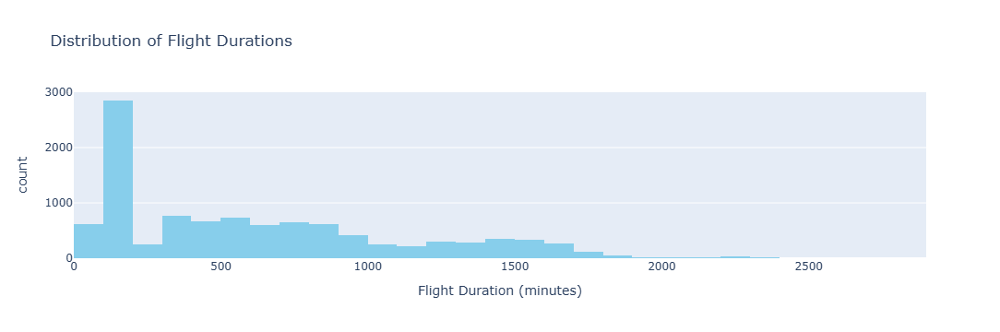

In [74]:
fig = px.histogram(df, 
                   x='Total_Duration_time_in_minutes', 
                   nbins=30, 
                   title='Distribution of Flight Durations',
                   labels={'Total_Duration_time_in_minutes': 'Flight Duration (minutes)'}, 
                   color_discrete_sequence=['skyblue'])

# Show the figure
fig.show()

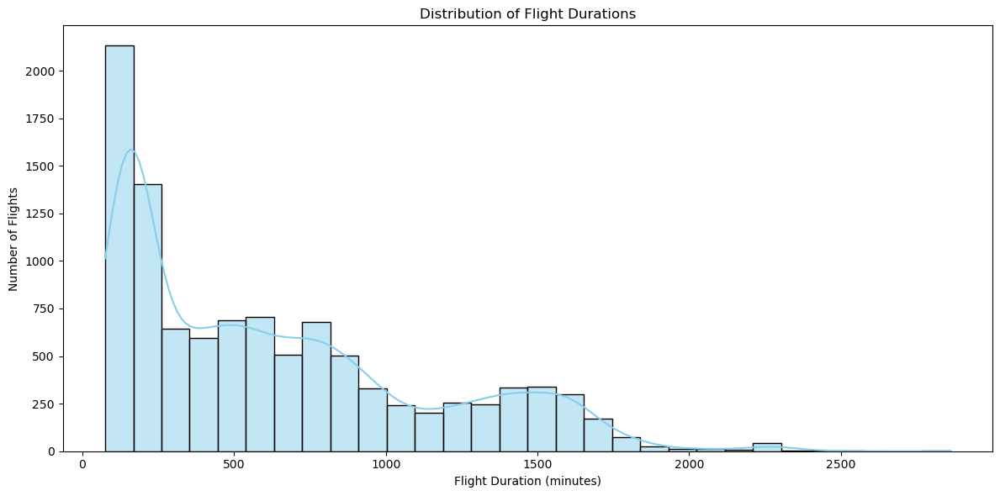

In [75]:
plt.figure(figsize=(12, 6))
sns.histplot(df['Total_Duration_time_in_minutes'], bins=30, kde=True, color='skyblue')

# Update titles and labels
plt.title('Distribution of Flight Durations')
plt.xlabel('Flight Duration (minutes)')
plt.ylabel('Number of Flights')

# Show the plot
plt.tight_layout()
plt.show()

### What are the mean and median flight durations, and how do they compare?

In [76]:
mean_duration = df['Total_Duration_time_in_minutes'].mean()
median_duration = df['Total_Duration_time_in_minutes'].median()

# Print the results
print(f"Mean Flight Duration: {mean_duration:.2f} minutes")
print(f"Median Flight Duration: {median_duration:.2f} minutes")

Mean Flight Duration: 629.90 minutes
Median Flight Duration: 505.00 minutes


### Bivariate Analysis 

### How does the airline affect flight prices?

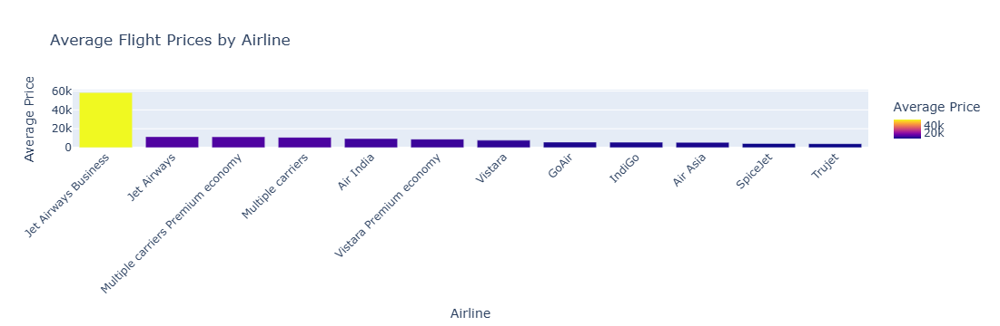

In [77]:
average_price = df.groupby('Airline')['Price'].mean().reset_index()
average_price = average_price.sort_values(by='Price', ascending=False)

# Create a bar plot for average prices by airline
fig_bar = px.bar(average_price, 
                 x='Airline', 
                 y='Price', 
                 title='Average Flight Prices by Airline', 
                 labels={'Airline': 'Airline', 'Price': 'Average Price'},
                 color='Price')

# Show the figure
fig_bar.update_layout(xaxis_title='Airline', yaxis_title='Average Price', xaxis_tickangle=-45)
fig_bar.show()

### What is the relationship between the number of stops and flight prices?

              count          mean          std      min      25%      50%  \
Total_Stops                                                                 
0            3473.0   5017.915635  2078.300779   1759.0   3858.0   4667.0   
1            5625.0  10594.123556  4281.645993   3480.0   7480.0  10262.0   
2            1318.0  12761.099393  3529.835696   4647.0  10697.0  12723.0   
3              43.0  13260.674419  2942.806813   8607.0  10703.0  13007.0   
4               1.0  17686.000000          NaN  17686.0  17686.0  17686.0   

                 75%      max  
Total_Stops                    
0             5678.0  31945.0  
1            13364.0  79512.0  
2            14237.0  52285.0  
3            15052.5  21829.0  
4            17686.0  17686.0  


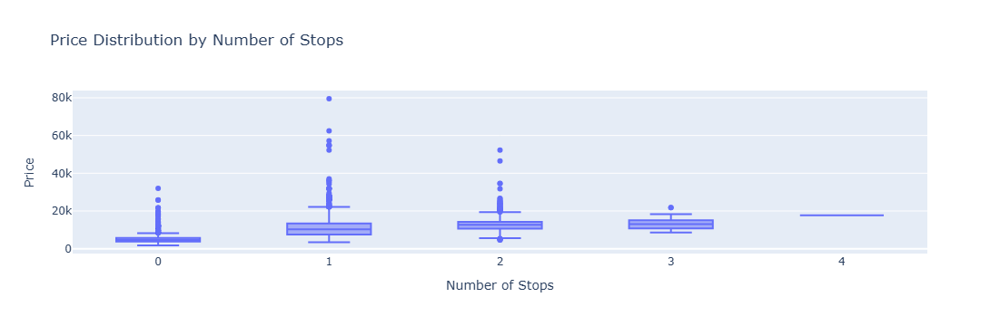

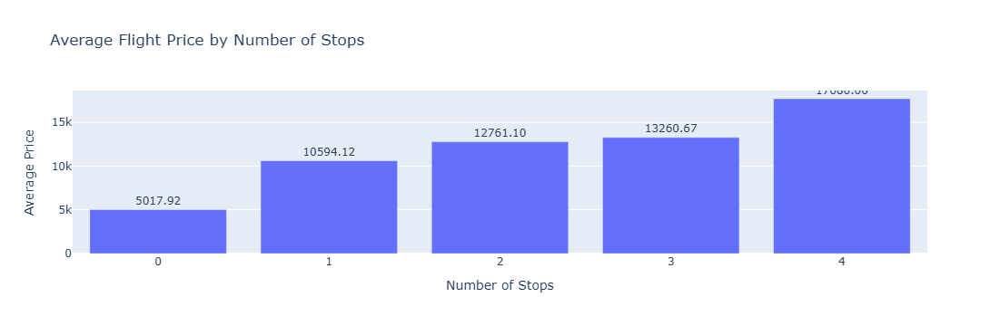

In [78]:
price_by_stops = df.groupby('Total_Stops')['Price'].describe()
print(price_by_stops)

# Visualization: Box Plot
fig_box = px.box(df, x='Total_Stops', y='Price', 
                 title='Price Distribution by Number of Stops',
                 labels={'Total_Stops': 'Number of Stops', 'Price': 'Price'})
fig_box.show()

# Visualization: Bar Chart of Average Prices
average_price_by_stops = df.groupby('Total_Stops')['Price'].mean().reset_index()
fig_bar = px.bar(average_price_by_stops, x='Total_Stops', y='Price',
                 title='Average Flight Price by Number of Stops',
                 labels={'Total_Stops': 'Number of Stops', 'Price': 'Average Price'},
                 text='Price')
fig_bar.update_traces(texttemplate='%{text:.2f}', textposition='outside')
fig_bar.show()

### Is there a correlation between departure times and flight prices?

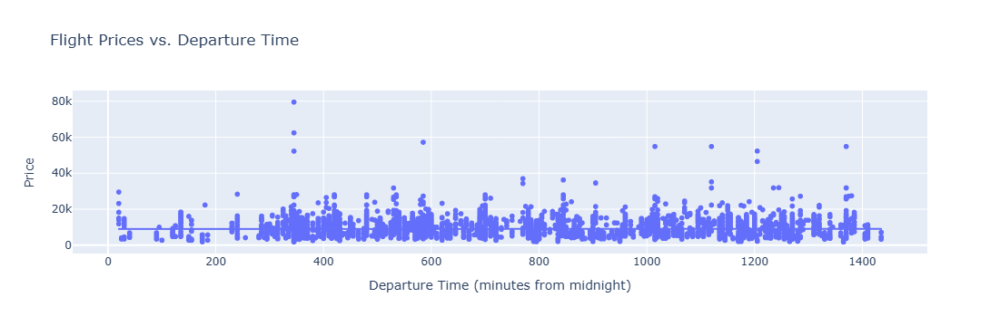

Correlation between departure time and price: 0.004046076995907048


In [79]:
df['Departure_Time'] = df['Dept_hour'] * 60 + df['Dept_min']

# Visualization: Scatter Plot
fig_scatter = px.scatter(df, x='Departure_Time', y='Price',
                         title='Flight Prices vs. Departure Time',
                         labels={'Departure_Time': 'Departure Time (minutes from midnight)', 'Price': 'Price'},
                         trendline='ols')  # Add a trendline for regression
fig_scatter.show()

# Correlation Calculation
correlation = df[['Departure_Time', 'Price']].corr().iloc[0, 1]
print('Correlation between departure time and price:', correlation)


### Do different source and destination pairs affect flight prices?

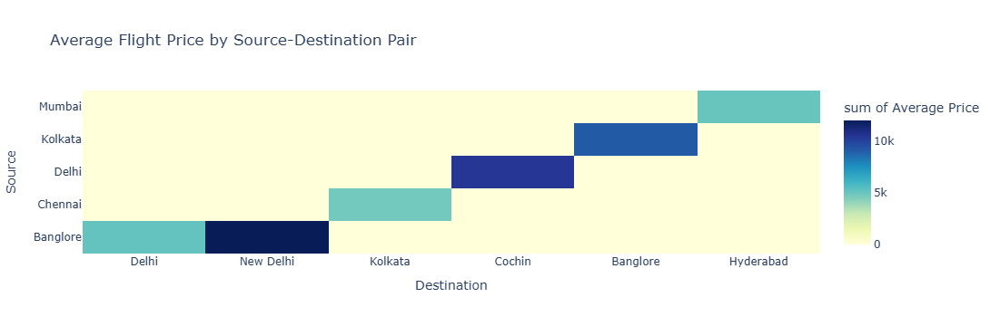

In [80]:
avg_price = df.groupby(['Source', 'Destination'])['Price'].mean().reset_index()

# Visualization: Heatmap
fig_heatmap = px.density_heatmap(
    avg_price,
    x='Destination',
    y='Source',
    z='Price',
    title='Average Flight Price by Source-Destination Pair',
    labels={'Price': 'Average Price'},
    color_continuous_scale='YlGnBu',
    hover_data={'Price': True}  # Show average price on hover
)
fig_heatmap.show()


### How does the total duration of flights relate to their prices?

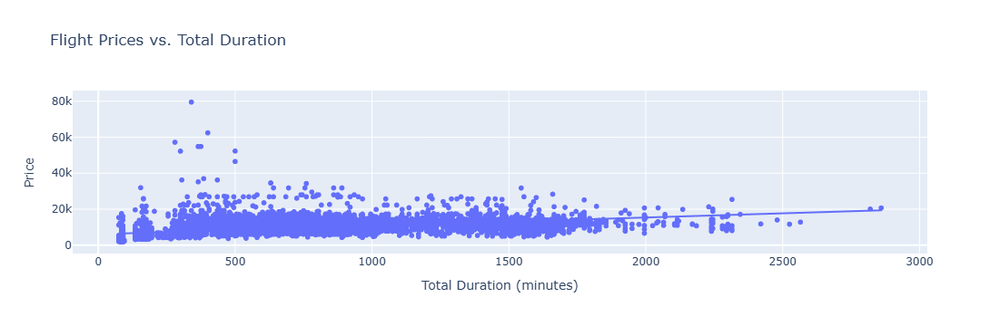

Correlation between total duration and price: 0.5018379909273424


In [81]:
fig_scatter = px.scatter(df, x='Total_Duration_time_in_minutes', y='Price',
                         title='Flight Prices vs. Total Duration',
                         labels={'Total_Duration_time_in_minutes': 'Total Duration (minutes)', 'Price': 'Price'},
                         trendline='ols')  # Add a trendline for regression
fig_scatter.show()

# Correlation Calculation
correlation = df[['Total_Duration_time_in_minutes', 'Price']].corr().iloc[0, 1]
print('Correlation between total duration and price:', correlation)

### Is there a seasonal effect on flight prices based on the month?

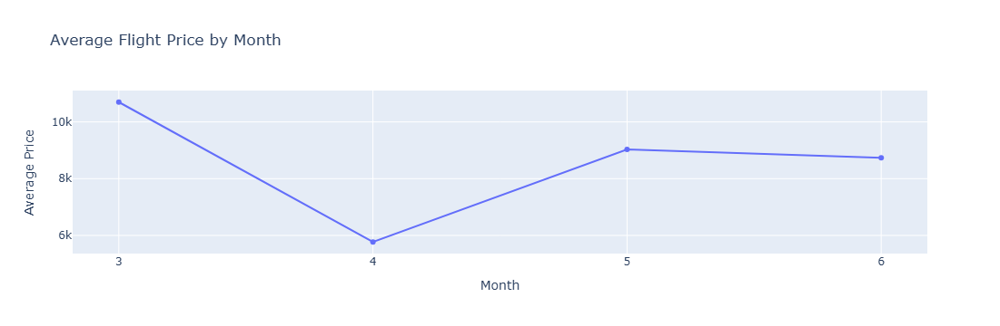

In [82]:
avg_price_by_month = df.groupby('Month')['Price'].mean().reset_index()

# Visualization: Line Plot
fig_line = px.line(avg_price_by_month, x='Month', y='Price',
                   title='Average Flight Price by Month',
                   labels={'Month': 'Month', 'Price': 'Average Price'},
                   markers=True)  # Markers for better visibility
fig_line.update_xaxes(tickmode='linear')  # Ensure all months are shown
fig_line.show()

### How does the additional information category impact flight prices?

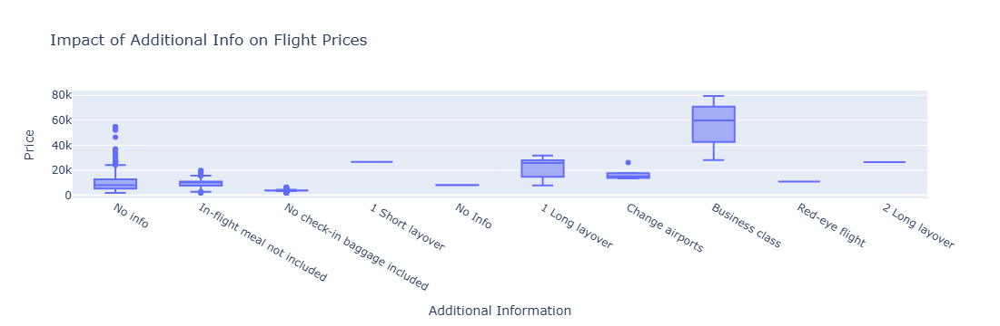

In [83]:
fig_box = px.box(df, x='Additional_Info', y='Price',
                 title='Impact of Additional Info on Flight Prices',
                 labels={'Additional_Info': 'Additional Information', 'Price': 'Price'})
fig_box.show()

### What is the relationship between arrival times and flight prices?

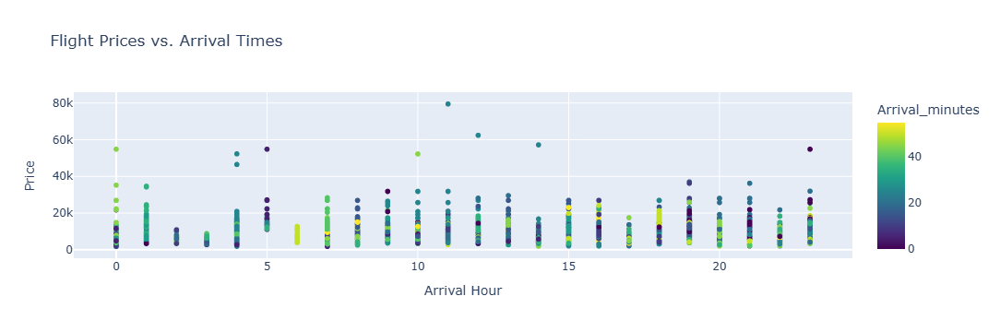

Correlation between Arrival Hours and Price: 0.030821107401336846


In [84]:
fig_scatter = px.scatter(df, 
                         x='Arrival_hours', 
                         y='Price',
                         color='Arrival_minutes',  
                         title='Flight Prices vs. Arrival Times',
                         labels={'Arrival_hours': 'Arrival Hour', 'Price': 'Price'},
                         color_continuous_scale=px.colors.sequential.Viridis)  
fig_scatter.show()

# Correlation Calculation between arrival time (as hours) and price
correlation_hours = df[['Arrival_hours', 'Price']].corr().iloc[0, 1]
print('Correlation between Arrival Hours and Price:', correlation_hours)


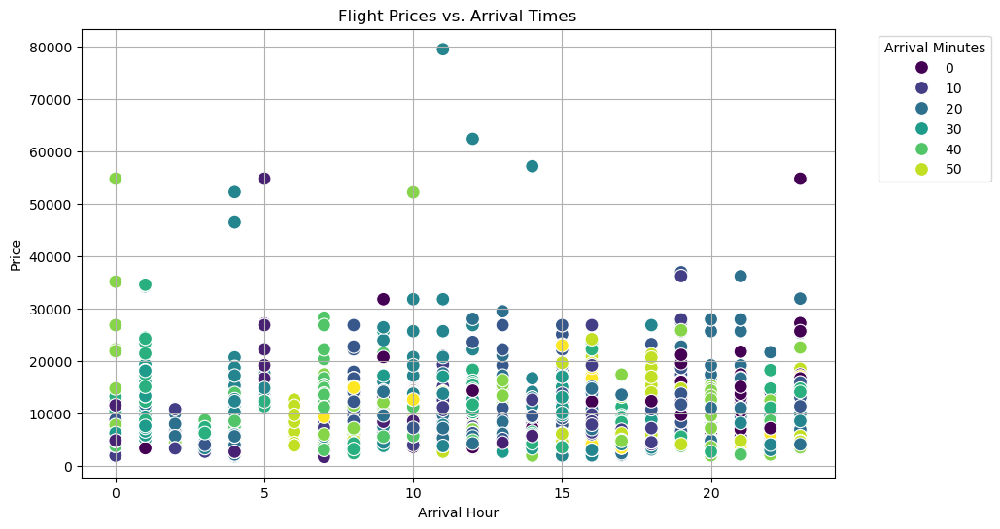

Correlation between Arrival Hours and Price: 0.030821107401336846


In [85]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Arrival_hours', y='Price', hue='Arrival_minutes', palette='viridis', data=df, s=100)
plt.title('Flight Prices vs. Arrival Times')
plt.xlabel('Arrival Hour')
plt.ylabel('Price')
plt.legend(title='Arrival Minutes', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid()
plt.show()

# Correlation Calculation between Arrival Hours and Price
correlation_hours = df[['Arrival_hours', 'Price']].corr().iloc[0, 1]
print('Correlation between Arrival Hours and Price:', correlation_hours)

### Are there trends in flight prices over different dates?

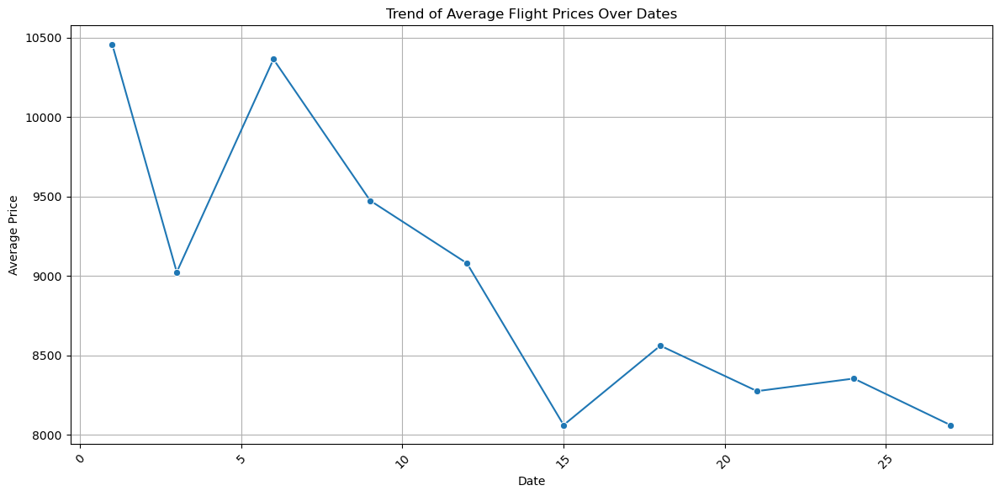

In [86]:


# Group by date and calculate average prices
avg_price_by_date = df.groupby('Date')['Price'].mean().reset_index()

# Visualization: Line Plot
plt.figure(figsize=(12, 6))
sns.lineplot(x='Date', y='Price', data=avg_price_by_date, marker='o')
plt.title('Trend of Average Flight Prices Over Dates')
plt.xlabel('Date')
plt.ylabel('Average Price')
plt.xticks(rotation=45)
plt.grid()
plt.tight_layout()
plt.show()

### Does the source city have a significant impact on the total flight duration?

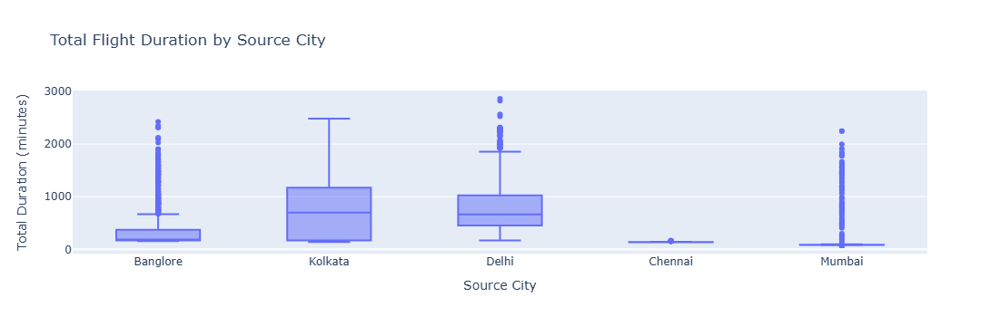

In [87]:
fig = px.box(df, x='Source', y='Total_Duration_time_in_minutes',
             title='Total Flight Duration by Source City',
             labels={'Source': 'Source City', 'Total_Duration_time_in_minutes': 'Total Duration (minutes)'})
fig.show()

### Multivariate Analysis

#### How do multiple factors (e.g., Airline, Source, Destination) together influence flight prices?"

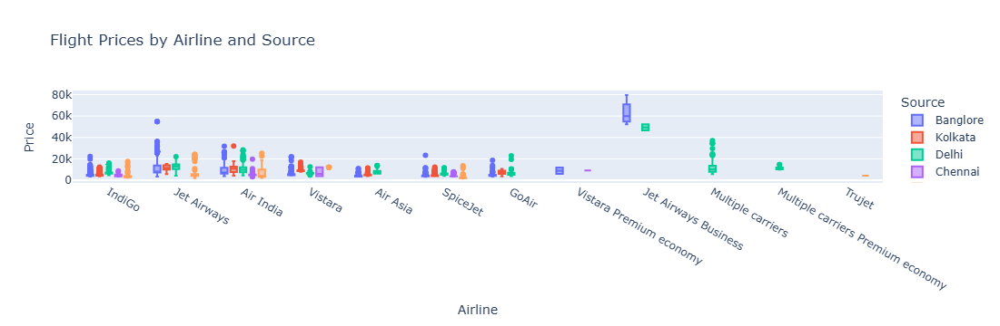

In [88]:
fig = px.box(df, x='Airline', y='Price', color='Source',
             title='Flight Prices by Airline and Source',
             labels={'Airline': 'Airline', 'Price': 'Price', 'Source': 'Source'})
fig.update_layout(xaxis_title='Airline', yaxis_title='Price')
fig.show()

#### What is the impact of Total Stops and Total Duration on flight prices when considering the Airline?

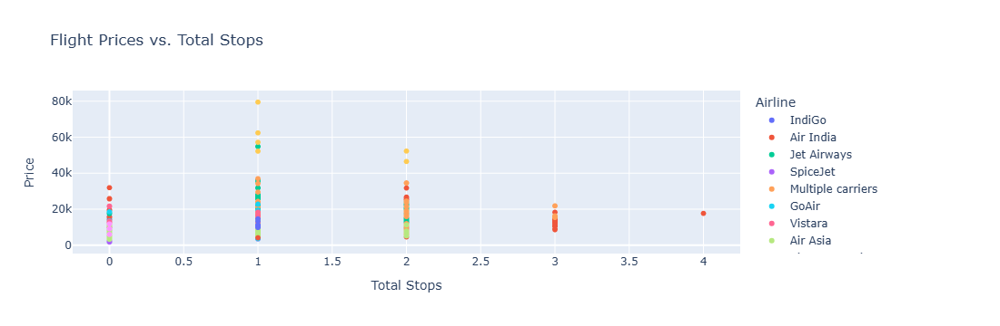

In [89]:
fig = px.scatter(df, x='Total_Stops', y='Price', color='Airline',
                 title='Flight Prices vs. Total Stops',
                 labels={'Total_Stops': 'Total Stops', 'Price': 'Price'})
fig.update_layout(xaxis_title='Total Stops', yaxis_title='Price')
fig.show()

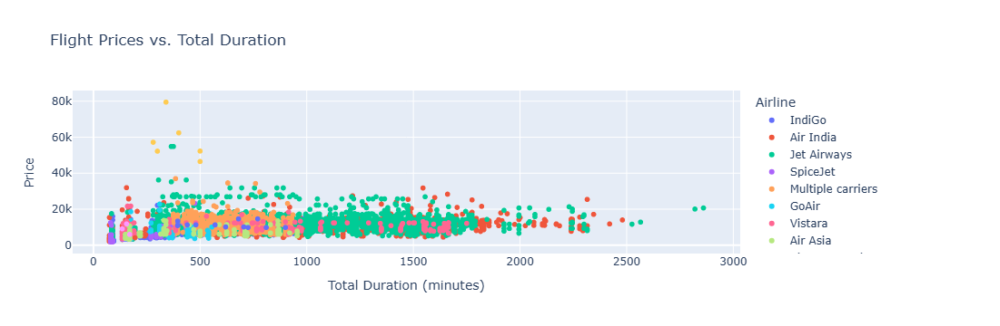

In [90]:
fig = px.scatter(df, x='Total_Duration_time_in_minutes', y='Price', color='Airline',
                 title='Flight Prices vs. Total Duration',
                 labels={'Total_Duration_time_in_minutes': 'Total Duration (minutes)', 'Price': 'Price'})
fig.update_layout(xaxis_title='Total Duration (minutes)', yaxis_title='Price')
fig.show()

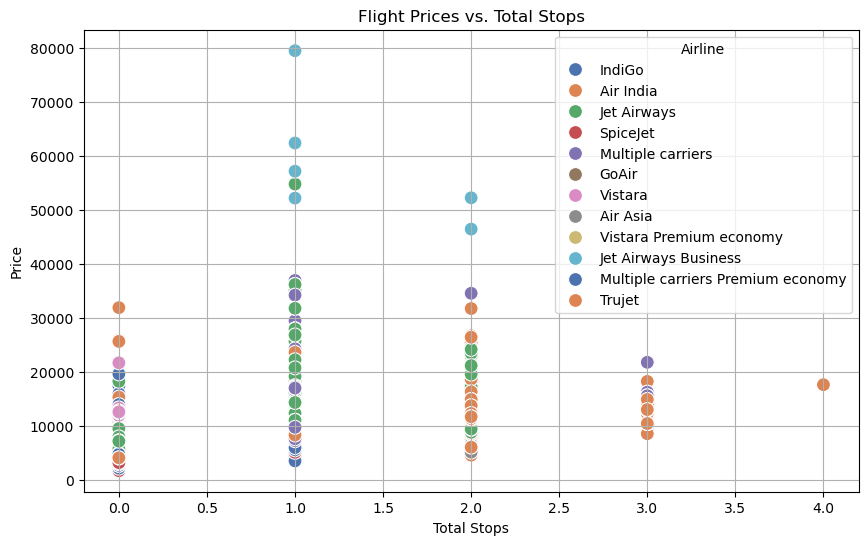

In [91]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Total_Stops', y='Price', hue='Airline', data=df, palette='deep', s=100)
plt.title('Flight Prices vs. Total Stops')
plt.xlabel('Total Stops')
plt.ylabel('Price')
plt.grid()
plt.show()

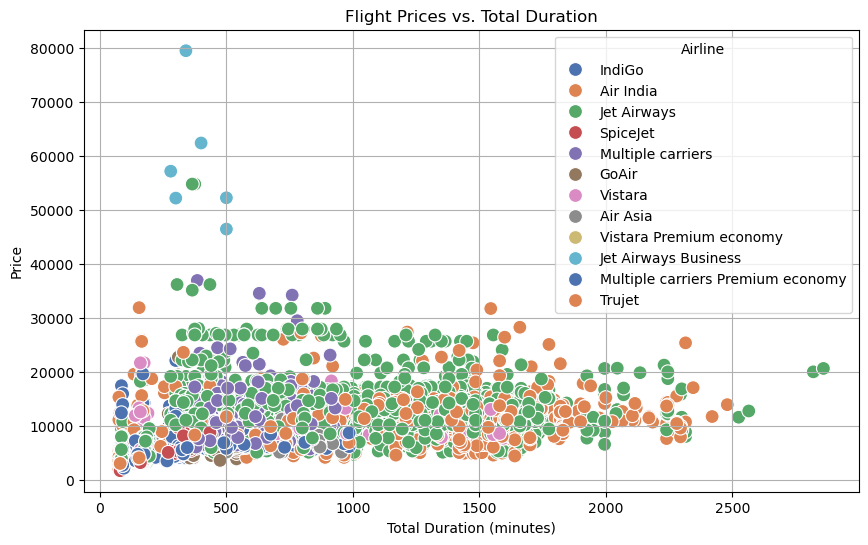

In [92]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Total_Duration_time_in_minutes', y='Price', hue='Airline', data=df, palette='deep', s=100)
plt.title('Flight Prices vs. Total Duration')
plt.xlabel('Total Duration (minutes)')
plt.ylabel('Price')
plt.grid()
plt.show()

#### Do different combinations of Source, Destination, and Total Stops affect flight prices?

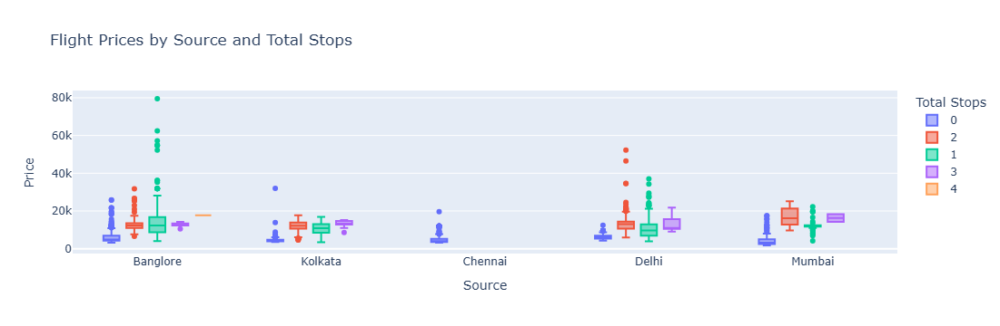

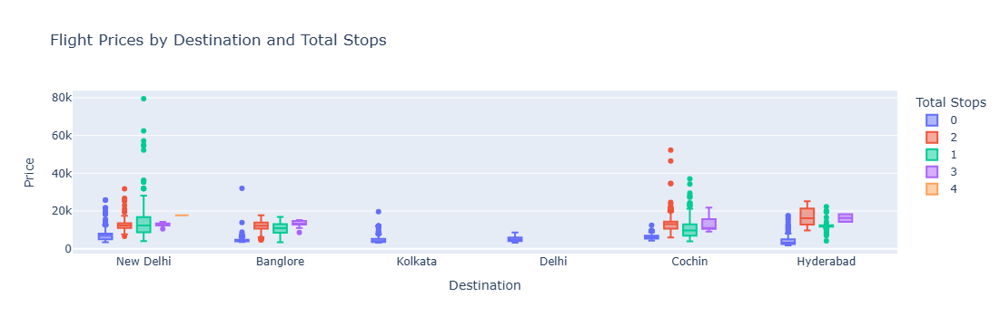

In [93]:
fig = px.box(df, x='Source', y='Price', color='Total_Stops',
             title='Flight Prices by Source and Total Stops',
             labels={'Source': 'Source', 'Price': 'Price', 'Total_Stops': 'Total Stops'})
fig.update_layout(xaxis_title='Source', yaxis_title='Price')
fig.show()

# Additionally, create a similar box plot for Destination
fig = px.box(df, x='Destination', y='Price', color='Total_Stops',
             title='Flight Prices by Destination and Total Stops',
             labels={'Destination': 'Destination', 'Price': 'Price', 'Total_Stops': 'Total Stops'})
fig.update_layout(xaxis_title='Destination', yaxis_title='Price')
fig.show()

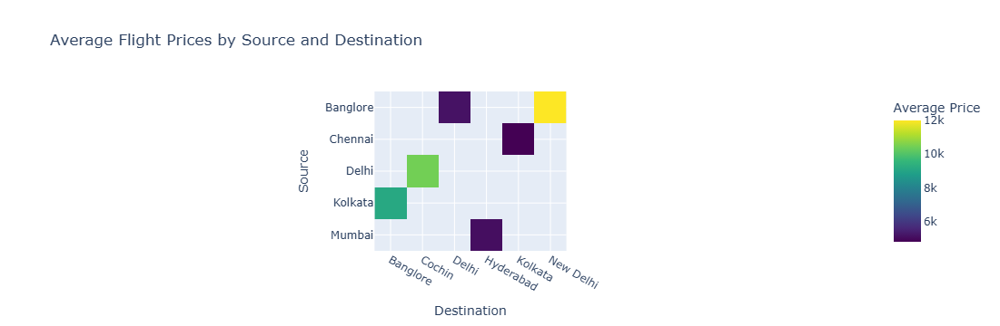

In [94]:
heatmap_data = df.pivot_table(values='Price', index='Source', columns='Destination', aggfunc='mean')

# Create the heatmap
fig = px.imshow(heatmap_data, 
                labels=dict(x="Destination", y="Source", color="Average Price"),
                title="Average Flight Prices by Source and Destination",
                color_continuous_scale='Viridis')

fig.show()

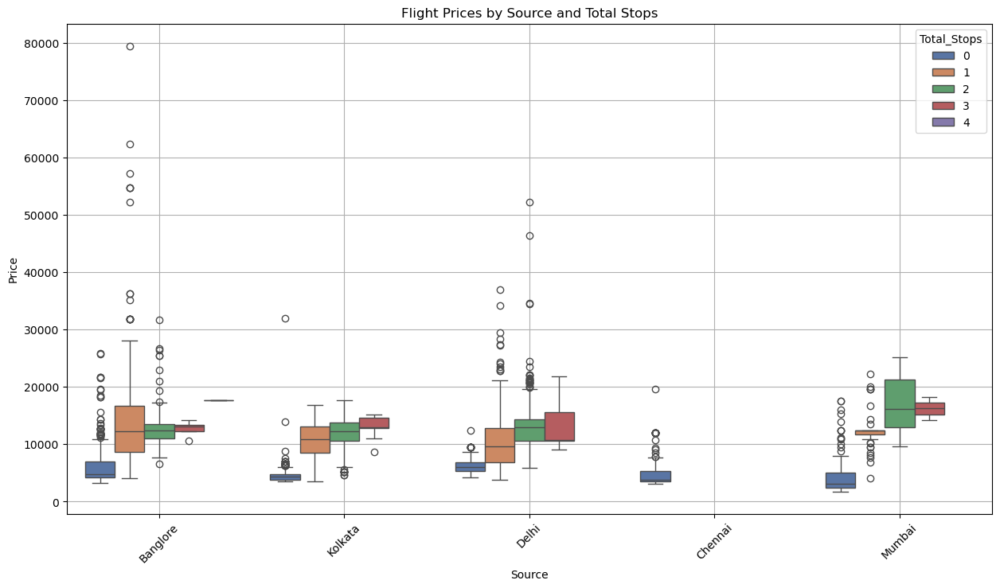

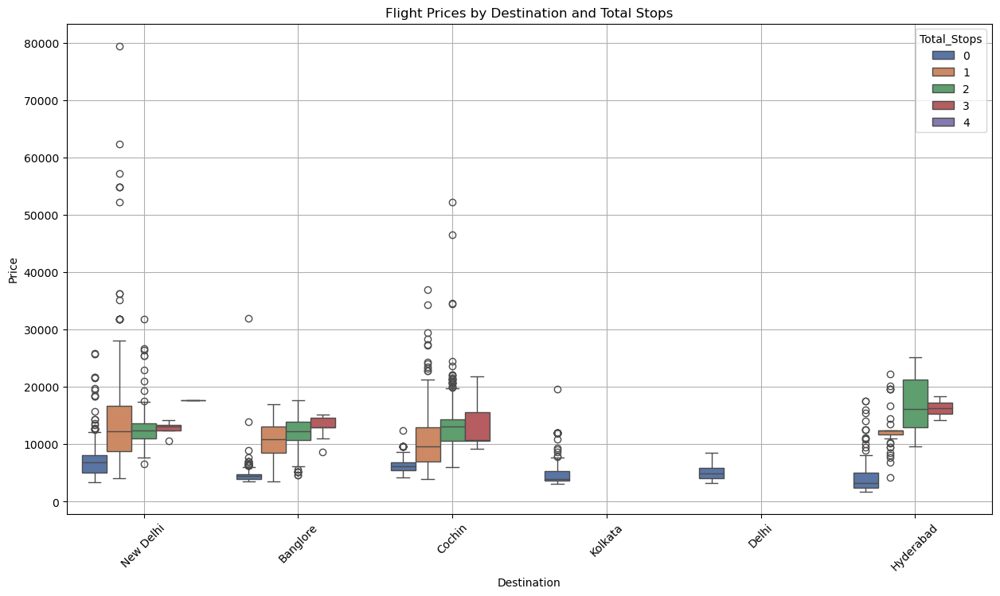

In [95]:
plt.figure(figsize=(15, 8))
sns.boxplot(x='Source', y='Price', hue='Total_Stops', data=df, palette='deep')
plt.title('Flight Prices by Source and Total Stops')
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Additionally, you can create a similar plot for Destination
plt.figure(figsize=(15, 8))
sns.boxplot(x='Destination', y='Price', hue='Total_Stops', data=df, palette='deep')
plt.title('Flight Prices by Destination and Total Stops')
plt.xticks(rotation=45)
plt.grid()
plt.show()

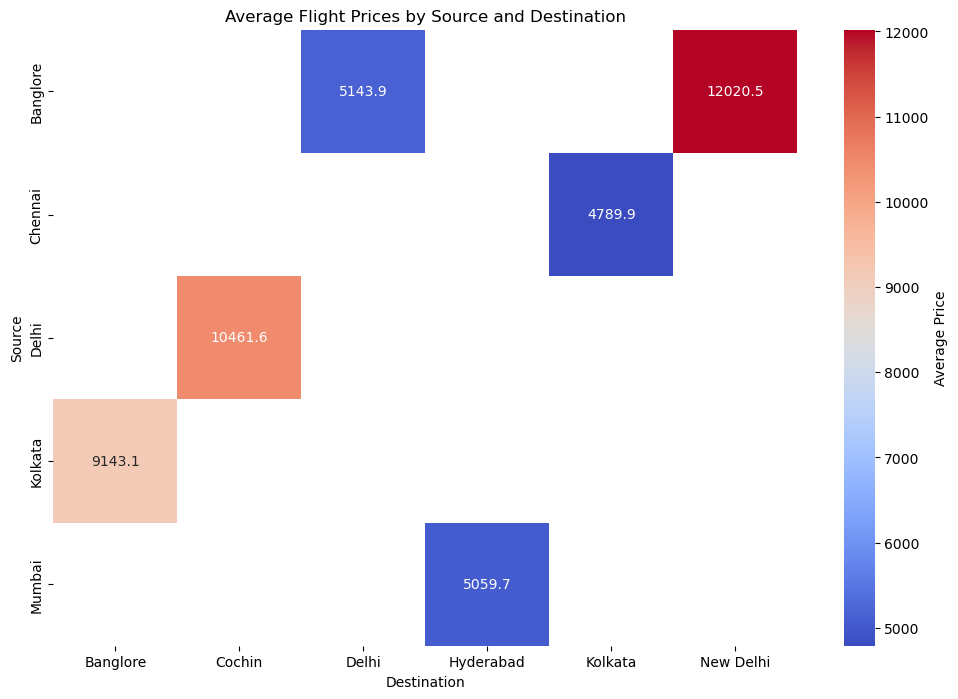

In [96]:
heatmap_data = df.pivot_table(values='Price', index='Source', columns='Destination', aggfunc='mean')

# Create the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, annot=True, fmt=".1f", cmap='coolwarm', cbar_kws={'label': 'Average Price'})
plt.title('Average Flight Prices by Source and Destination')
plt.xlabel('Destination')
plt.ylabel('Source')
plt.show()

#### Is there a seasonal effect (Month) on flight prices across different Airlines?

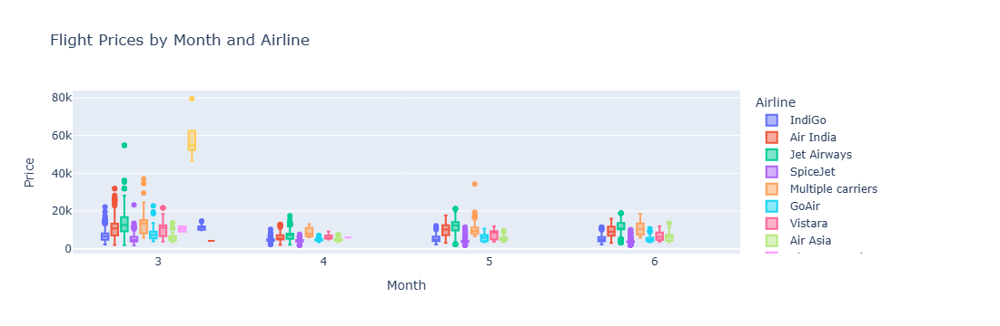

In [97]:
fig = px.box(df, x='Month', y='Price', color='Airline',
             title='Flight Prices by Month and Airline',
             labels={'Month': 'Month', 'Price': 'Price', 'Airline': 'Airline'})
fig.update_layout(xaxis_title='Month', yaxis_title='Price')
fig.show()

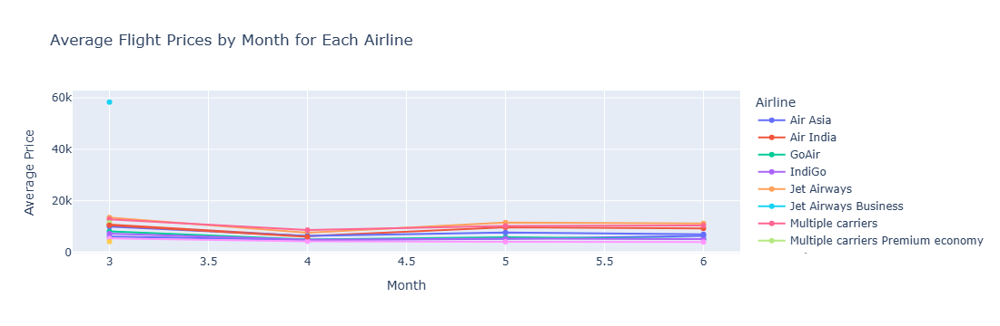

In [98]:
avg_price_by_month = df.groupby(['Month', 'Airline'])['Price'].mean().reset_index()

# Create a line plot
fig = px.line(avg_price_by_month, x='Month', y='Price', color='Airline',
              title='Average Flight Prices by Month for Each Airline',
              labels={'Month': 'Month', 'Price': 'Average Price', 'Airline': 'Airline'},
              markers=True)
fig.update_layout(xaxis_title='Month', yaxis_title='Average Price')
fig.show()

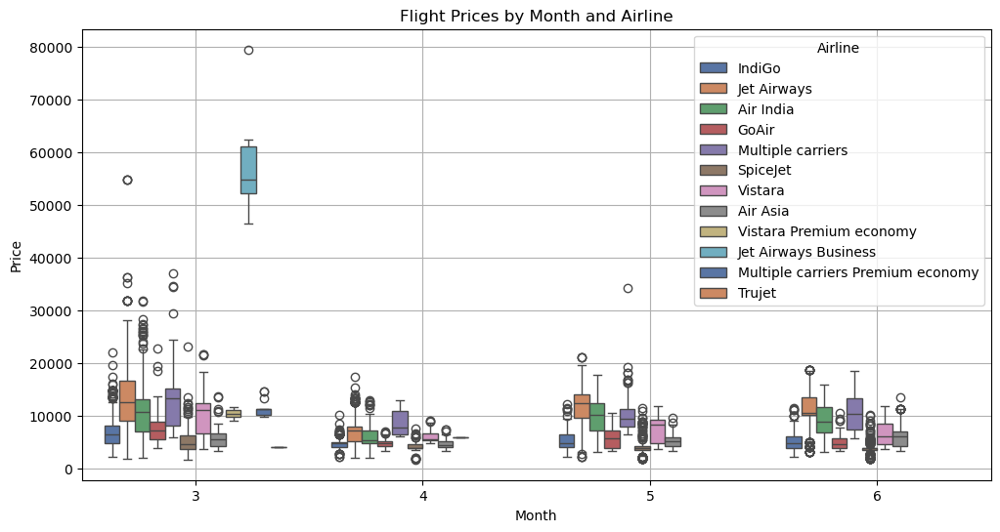

In [99]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='Month', y='Price', hue='Airline', data=df, palette='deep')
plt.title('Flight Prices by Month and Airline')
plt.xlabel('Month')
plt.ylabel('Price')
plt.grid()
plt.legend(title='Airline')
plt.show()

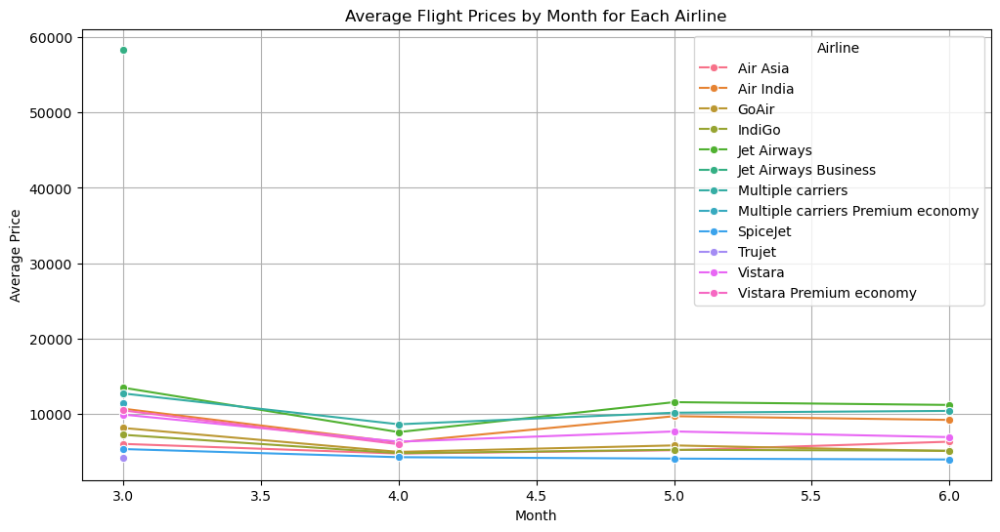

In [100]:
avg_price_by_month = df.groupby(['Month', 'Airline'])['Price'].mean().reset_index()

# Create a line plot
plt.figure(figsize=(12, 6))
sns.lineplot(data=avg_price_by_month, x='Month', y='Price', hue='Airline', marker='o')
plt.title('Average Flight Prices by Month for Each Airline')
plt.xlabel('Month')
plt.ylabel('Average Price')
plt.grid()
plt.legend(title='Airline')
plt.show()

#### How do arrival times (Arrival_hours and Arrival_minutes) correlate with flight prices while considering the Total Stops?

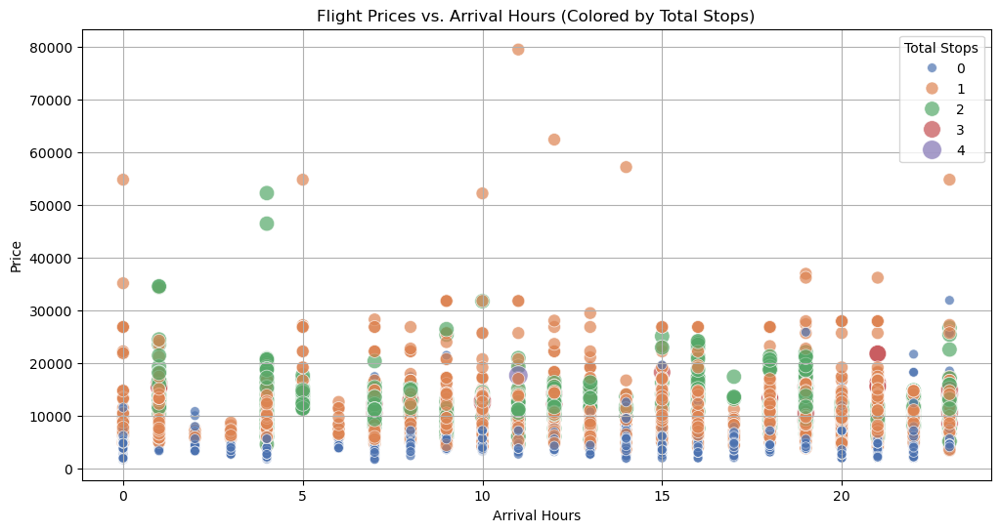

In [101]:
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Arrival_hours', y='Price', hue='Total_Stops', data=df, palette='deep', size='Total_Stops', sizes=(50, 200), alpha=0.7)
plt.title('Flight Prices vs. Arrival Hours (Colored by Total Stops)')
plt.xlabel('Arrival Hours')
plt.ylabel('Price')
plt.grid()
plt.legend(title='Total Stops')
plt.show()

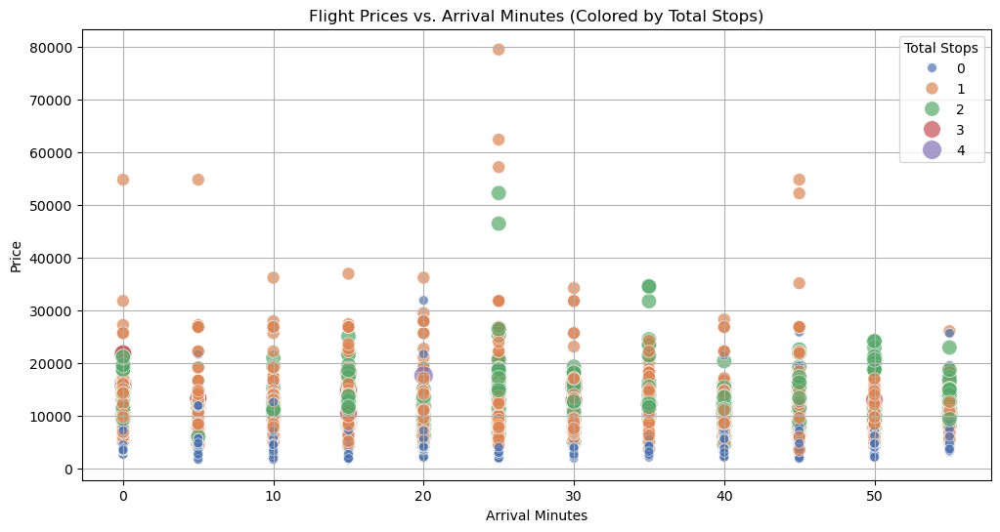

In [102]:
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Arrival_minutes', y='Price', hue='Total_Stops', data=df, palette='deep', size='Total_Stops', sizes=(50, 200), alpha=0.7)
plt.title('Flight Prices vs. Arrival Minutes (Colored by Total Stops)')
plt.xlabel('Arrival Minutes')
plt.ylabel('Price')
plt.grid()
plt.legend(title='Total Stops')
plt.show()

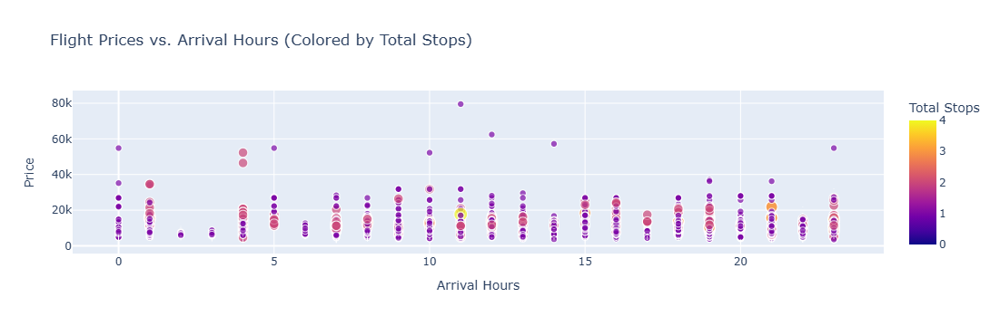

In [103]:
fig = px.scatter(df, x='Arrival_hours', y='Price', color='Total_Stops',
                 size='Total_Stops', size_max=15,
                 title='Flight Prices vs. Arrival Hours (Colored by Total Stops)',
                 labels={'Arrival_hours': 'Arrival Hours', 'Price': 'Price', 'Total_Stops': 'Total Stops'})
fig.update_layout(xaxis_title='Arrival Hours', yaxis_title='Price')
fig.show()

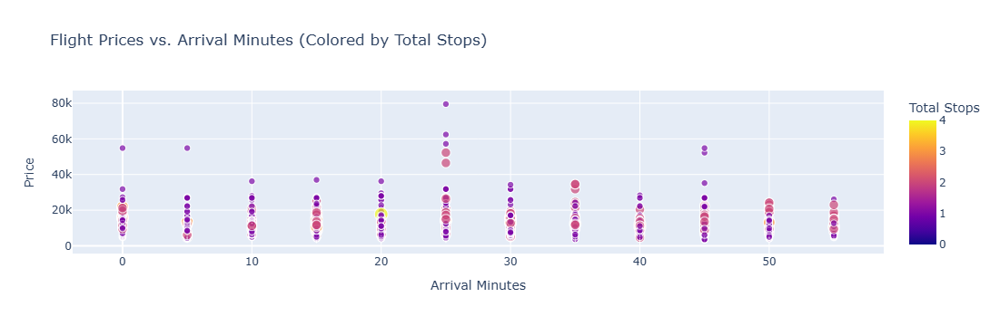

In [104]:
fig = px.scatter(df, x='Arrival_minutes', y='Price', color='Total_Stops',
                 size='Total_Stops', size_max=15,
                 title='Flight Prices vs. Arrival Minutes (Colored by Total Stops)',
                 labels={'Arrival_minutes': 'Arrival Minutes', 'Price': 'Price', 'Total_Stops': 'Total Stops'})
fig.update_layout(xaxis_title='Arrival Minutes', yaxis_title='Price')
fig.show()

### Preprocessing for ML

In [105]:
df.columns

Index(['Airline', 'Source', 'Destination', 'Total_Stops', 'Additional_Info',
       'Price', 'Date', 'Month', 'Arrival_hours', 'Arrival_minutes',
       'Dept_hour', 'Dept_min', 'Total_Duration_time_in_minutes',
       'Departure_Time'],
      dtype='object')

In [106]:
# Split data into input features and target variable
x = df.drop('Price', axis= 1)
y = df['Price']

In [107]:
x

,Airline,Source,Destination,Total_Stops,Additional_Info,Date,Month,Arrival_hours,Arrival_minutes,Dept_hour,Dept_min,Total_Duration_time_in_minutes,Departure_Time
0,IndiGo,Banglore,New Delhi,0,No info,24,3,1,10,22,20,170,1340
1,Air India,Kolkata,Banglore,2,No info,1,5,13,15,5,50,445,350
2,Jet Airways,Delhi,Cochin,2,No info,9,6,4,25,9,25,1140,565
3,IndiGo,Kolkata,Banglore,1,No info,12,5,23,30,18,5,325,1085
4,IndiGo,Banglore,New Delhi,1,No info,1,3,21,35,16,50,285,1010
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10457,Air Asia,Kolkata,Banglore,0,No info,9,4,22,25,19,55,150,1195
10458,Air India,Kolkata,Banglore,0,No info,27,4,23,20,20,45,155,1245
10459,Jet Airways,Banglore,Delhi,0,No info,27,4,11,20,8,20,180,500
10460,Vistara,Banglore,New Delhi,0,No info,1,3,14,10,11,30,160,690


In [108]:
df.Date.value_counts()

Date
9     1375
6     1268
27    1092
21    1085
1     1058
24    1021
15     967
12     946
3      834
18     814
Name: count, dtype: int64

In [109]:
df["Departure_Time"].unique().tolist()

[1340,
 350,
 565,
 1085,
 1010,
 540,
 1135,
 480,
 535,
 685,
 585,
 1220,
 700,
 1270,
 1035,
 1000,
 525,
 840,
 1215,
 960,
 850,
 1320,
 240,
 1285,
 1310,
 420,
 425,
 590,
 875,
 635,
 905,
 855,
 405,
 1255,
 670,
 345,
 1140,
 1385,
 660,
 575,
 1275,
 1435,
 1185,
 530,
 940,
 365,
 900,
 835,
 355,
 800,
 305,
 385,
 1050,
 500,
 1195,
 390,
 845,
 120,
 580,
 505,
 1225,
 795,
 135,
 1015,
 1245,
 315,
 1190,
 1200,
 370,
 1170,
 285,
 775,
 1095,
 1040,
 925,
 1380,
 720,
 885,
 710,
 690,
 880,
 1150,
 360,
 1410,
 455,
 785,
 750,
 910,
 770,
 1105,
 990,
 40,
 410,
 780,
 1155,
 90,
 1020,
 600,
 1175,
 930,
 730,
 970,
 1235,
 1345,
 1265,
 335,
 310,
 400,
 915,
 30,
 510,
 430,
 330,
 865,
 325,
 620,
 1065,
 790,
 1330,
 295,
 1070,
 1280,
 380,
 955,
 1230,
 1045,
 570,
 450,
 155,
 655,
 1030,
 550,
 1125,
 920,
 1370,
 895,
 860,
 805,
 1335,
 665,
 975,
 1210,
 415,
 1145,
 475,
 465,
 610,
 495,
 695,
 1260,
 1075,
 1005,
 1100,
 230,
 515,
 1160,
 1205,
 1060

In [110]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler

num_pipeline = Pipeline(steps= [('Scaling' , RobustScaler())])
num_pipeline

Pipeline(steps=[('Scaling', RobustScaler())])

In [111]:
### Categorical data types
df.select_dtypes(include= 'O')

,Airline,Source,Destination,Additional_Info
0,IndiGo,Banglore,New Delhi,No info
1,Air India,Kolkata,Banglore,No info
2,Jet Airways,Delhi,Cochin,No info
3,IndiGo,Kolkata,Banglore,No info
4,IndiGo,Banglore,New Delhi,No info
...,...,...,...,...
10457,Air Asia,Kolkata,Banglore,No info
10458,Air India,Kolkata,Banglore,No info
10459,Jet Airways,Banglore,Delhi,No info
10460,Vistara,Banglore,New Delhi,No info


In [112]:
df.Airline.value_counts()#binary

Airline
Jet Airways                          3700
IndiGo                               2043
Air India                            1694
Multiple carriers                    1196
SpiceJet                              815
Vistara                               477
Air Asia                              318
GoAir                                 194
Multiple carriers Premium economy      13
Jet Airways Business                    6
Vistara Premium economy                 3
Trujet                                  1
Name: count, dtype: int64

In [113]:
df.Source.value_counts()

Source
Delhi       4345
Kolkata     2860
Banglore    2177
Mumbai       697
Chennai      381
Name: count, dtype: int64

In [114]:
df.Destination.value_counts()

Destination
Cochin       4345
Banglore     2860
Delhi        1265
New Delhi     912
Hyderabad     697
Kolkata       381
Name: count, dtype: int64

In [115]:
df.Additional_Info.value_counts()#binary

Additional_Info
No info                         8180
In-flight meal not included     1926
No check-in baggage included     318
1 Long layover                    19
Change airports                    7
Business class                     4
No Info                            3
1 Short layover                    1
Red-eye flight                     1
2 Long layover                     1
Name: count, dtype: int64

In [116]:
# Categorical Nominal (OHE) Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder
from category_encoders import BinaryEncoder

In [117]:
ohe_pipeline = Pipeline(steps= [('OHE', OneHotEncoder(drop= 'first'))])
ohe_pipeline

Pipeline(steps=[('OHE', OneHotEncoder(drop='first'))])

In [118]:

BE_pipeline = Pipeline(steps= [('BE', BinaryEncoder())])
BE_pipeline



Pipeline(steps=[('BE', BinaryEncoder())])

In [119]:
ohe_cols= ['Source','Destination']

In [120]:
BE_cols= ['Airline', 'Additional_Info']

In [121]:
#Numerical Features
num_cols = x.select_dtypes(exclude= 'O').columns
num_cols

Index(['Total_Stops', 'Date', 'Month', 'Arrival_hours', 'Arrival_minutes',
       'Dept_hour', 'Dept_min', 'Total_Duration_time_in_minutes',
       'Departure_Time'],
      dtype='object')

In [122]:
from sklearn.compose import ColumnTransformer

preprocessing = ColumnTransformer(transformers= [ ('ohe_pipeline', ohe_pipeline, ohe_cols),
                                                ('BE_pipeline', BE_pipeline, BE_cols)])
preprocessing              

ColumnTransformer(transformers=[('ohe_pipeline',
                                 Pipeline(steps=[('OHE',
                                                  OneHotEncoder(drop='first'))]),
                                 ['Source', 'Destination']),
                                ('BE_pipeline',
                                 Pipeline(steps=[('BE', BinaryEncoder())]),
                                 ['Airline', 'Additional_Info'])])

In [123]:
from sklearn.ensemble import RandomForestRegressor

# Create a full pipeline
model_pipeline = Pipeline(steps=[('preprocessing', preprocessing), ('model', RandomForestRegressor())])


In [124]:
#from sklearn.model_selection import train_test_split

#X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)


In [125]:
#model_pipeline.fit(X_train, y_train)


In [126]:
from sklearn.model_selection import cross_validate
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import RobustScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from xgboost import XGBRegressor  
from catboost import CatBoostRegressor

In [127]:
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree': DecisionTreeRegressor(),
    'Random Forest': RandomForestRegressor(),
    'Gradient Boosting': GradientBoostingRegressor(),
    'CatBoost': CatBoostRegressor(iterations=1000, learning_rate=0.1, depth=6, verbose=0),
    'Support Vector Regression': SVR(),
    'XGBoost': XGBRegressor()
}

# Train and evaluate each model
results = {}
for model_name, model in models.items():
    pipeline = Pipeline(steps=[
        ('Preprocessing', preprocessing),
        ('Model', model)
    ])
    
    cv_results = cross_validate(pipeline, x, y, cv=5, scoring='r2', return_train_score=True)
    results[model_name] = {
        'train_score': cv_results['train_score'],
        'test_score': cv_results['test_score']
    }

# Print results
for model_name, scores in results.items():
    train_percentage = scores['train_score'].mean() * 100
    test_percentage = scores['test_score'].mean() * 100
    print(f"{model_name} - Train R²: {train_percentage:.2f}%, Test R²: {test_percentage:.2f}%")


Linear Regression - Train R²: 47.29%, Test R²: 47.43%
Decision Tree - Train R²: 66.28%, Test R²: 65.26%
Random Forest - Train R²: 66.19%, Test R²: 65.03%
Gradient Boosting - Train R²: 63.98%, Test R²: 63.21%
CatBoost - Train R²: 66.28%, Test R²: 65.32%
Support Vector Regression - Train R²: 5.09%, Test R²: 5.03%
XGBoost - Train R²: 66.28%, Test R²: 64.87%


In [128]:
from sklearn.model_selection import GridSearchCV
from catboost import CatBoostRegressor
from sklearn.pipeline import Pipeline


param_grid = {
    'Model__iterations': [500, 1000, 1500],
    'Model__learning_rate': [0.01, 0.05, 0.1],
    'Model__depth': [4, 6, 8],
    'Model__l2_leaf_reg': [1, 3, 5],
    'Model__border_count': [32, 64],
}

ct_pipeline = Pipeline(steps=[
    ('Preprocessing', preprocessing), 
    ('Model', CatBoostRegressor(verbose=0)) 
])


grid_search = GridSearchCV(ct_pipeline, param_grid, cv=5, scoring='r2', n_jobs=-1, verbose=1, return_train_score=True)
grid_search.fit(x, y) 


print("Best Parameters:", grid_search.best_params_)


mean_train_score = grid_search.cv_results_['mean_train_score'].mean() * 100
print(f"Mean Train R²: {mean_train_score:.2f}%")

best_test_score = grid_search.score(x, y)
print(f"Best Test R²: {best_test_score:.2f}")



Fitting 5 folds for each of 162 candidates, totalling 810 fits
Best Parameters: {'Model__border_count': 32, 'Model__depth': 4, 'Model__iterations': 1500, 'Model__l2_leaf_reg': 5, 'Model__learning_rate': 0.05}
Mean Train R²: 65.85%
Best Test R²: 0.66


In [129]:
ct_pipeline.fit(x,y)

Pipeline(steps=[('Preprocessing',
                 ColumnTransformer(transformers=[('ohe_pipeline',
                                                  Pipeline(steps=[('OHE',
                                                                   OneHotEncoder(drop='first'))]),
                                                  ['Source', 'Destination']),
                                                 ('BE_pipeline',
                                                  Pipeline(steps=[('BE',
                                                                   BinaryEncoder())]),
                                                  ['Airline',
                                                   'Additional_Info'])])),
                ('Model',
                 <catboost.core.CatBoostRegressor object at 0x000001B8DA01CC50>)])

In [130]:
ct_pipeline.predict(x.head(1))[0]

7337.783135624375

In [131]:
x.columns

Index(['Airline', 'Source', 'Destination', 'Total_Stops', 'Additional_Info',
       'Date', 'Month', 'Arrival_hours', 'Arrival_minutes', 'Dept_hour',
       'Dept_min', 'Total_Duration_time_in_minutes', 'Departure_Time'],
      dtype='object')

In [132]:
# Save pipeline as pkl file
import joblib
joblib.dump(ct_pipeline, 'ct_pipeline.pkl')

['ct_pipeline.pkl']

In [133]:
df.to_csv('cleaned_df.csv')

In [1]:
%%writefile flight_price.py
import streamlit as st
import joblib
import pandas as pd
import numpy as np
import plotly.express as px
from sklearn.pipeline import Pipeline
from category_encoders import BinaryEncoder

select_page = st.sidebar.radio('Select page', ['Intoduction','Analysis', 'Model Regression'])

if select_page == 'Intoduction':
    
    def main():
        st.title('Flight Price Prediction ')
        
        #st.image('')
        
        st.write('### introduction to my data :')
        
        st.write('''In the rapidly evolving landscape of air travel, understanding and predicting flight prices has become crucial for both consumers and industry stakeholders. This project explores the factors influencing flight prices, utilizing data-driven techniques to forecast fare trends. By analyzing various parameters such as historical price data, seasonality, and economic indicators, we aim to develop an accurate predictive model that can assist travelers in making informed decisions. Leveraging machine learning algorithms, this initiative not only seeks to provide insights into pricing dynamics but also contributes to enhancing the overall travel experience by empowering users with knowledge of potential fare fluctuations.

                    discovery, every insightful trend, lies a team of dedicated professionals armed with the tools of analysis and the power of visualization. Welcome to our exploration of the dynamic landscape of data science careers and salaries, where numbers tell stories and trends reveal themselves in vibrant hues.

                ''')
        
        st.header('Dataset Feature Overview')
        
        st.write('''
                *Airline*: The name of the airline.
        
                *Date_of_Journey*: The date of the journey.
                
                *Source: The source from which the service begins. 
                
                *Destination*: The destination where the service ends.
                
                *Route*: The route taken by the flight to reach the destination.

                *Dep_Time*: The time when the journey starts from the source.

                *Arrival_Time*: Time of arrival at the destination.

                *Duration*: Total duration of the flight.

                *Total_Stops*: Total stops between the source and destination.

                *Additional_Info*: Additional information about the flight

                *Price*: The price of the ticket

                ''')
        
    if __name__ == '__main__': 
        main() 


if select_page == 'Analysis':
    def main():
        cleaned_df = pd.read_csv('cleaned_df.csv')
        st.write('### Head of Dataframe')
        st.dataframe(cleaned_df.head(10))
        
        tab1, tab2, tab3 = st.tabs(['Univariate Analysis', 'Bivariate Analysis', 'Multivariate Analysis'])
        
        tab1.write('### What is the frequency distribution of flights for each airline?')
        airline_counts = cleaned_df['Airline'].value_counts().reset_index()
        airline_counts.columns = ['Airline', 'Number of Flights']
        tab1.plotly_chart(px.bar(airline_counts, 
                         x='Airline', 
                         y='Number of Flights', 
                         title='Frequency Distribution of Flights for Each Airline',
                         color='Number of Flights',
                         text='Number of Flights'))
        tab1.write('### Which airline has the highest number of flights?')
        airline_counts = cleaned_df['Airline'].value_counts().reset_index()
        airline_counts.columns = ['Airline', 'Number of Flights']
        highest_airline = airline_counts.loc[airline_counts['Number of Flights'].idxmax()]
        tab1.plotly_chart(px.bar(airline_counts,
                         x='Airline',
                         y='Number of Flights',
                         title='Frequency Distribution of Flights for Each Airline',
                         color='Number of Flights',
                         text='Number of Flights'))
        tab1.write('### How many flights are departing from each source city?')
        source_counts = cleaned_df['Source'].value_counts().reset_index()
        source_counts.columns = ['Source', 'Number of Flights']
        tab1.plotly_chart( px.bar(source_counts,
                         x='Source',
                         y='Number of Flights',
                         title='Number of Flights Departing from Each Source City',
                         color='Number of Flights',
                         text='Number of Flights'))
        tab1.write('### What is the distribution of flights based on the number of stops (e.g., non-stop, 1 stop, etc.)?')
        stops_distribution = cleaned_df['Total_Stops'].value_counts().reset_index()
        stops_distribution.columns = ['Total Stops', 'Number of Flights']
        tab1.plotly_chart(px.bar(stops_distribution,
                         x='Total Stops',
                         y='Number of Flights',
                         title='Distribution of Flights Based on Number of Stops',
                         color='Number of Flights',
                         text='Number of Flights'))
        tab1.write('### How does the total number of stops affect the frequency of flights?')
        tab1.plotly_chart(px.bar(stops_distribution,
                         x='Total Stops',
                         y='Number of Flights',
                         title='Effect of Total Number of Stops on Frequency of Flights',
                         color='Number of Flights',
                         text='Number of Flights'))
        tab1.write('###  What are the most common additional info categories provided?')
        additional_info_counts = cleaned_df['Additional_Info'].value_counts().reset_index()
        additional_info_counts.columns = ['Additional Info', 'Count']
        tab1.plotly_chart(px.bar(additional_info_counts,
                         x='Additional Info',
                         y='Count',
                         title='Most Common Additional Info Categories',
                         color='Count',
                         text='Count'))
        tab1.write('###  What is the distribution of flight prices in the dataset?')
        tab1.plotly_chart(px.histogram(cleaned_df, 
                         x='Price', 
                         title='Distribution of Flight Prices',
                         nbins=30, 
                         labels={'Price': 'Flight Price'},
                         color_discrete_sequence=['blue']))
        tab1.write('###  How many flights are scheduled on each date?')
        flights_per_date = cleaned_df['Date'].value_counts().reset_index()
        flights_per_date.columns = ['Date', 'Number of Flights']
        flights_per_date = flights_per_date.sort_values(by='Date')
        tab1.plotly_chart(px.bar(flights_per_date, 
                         x='Date', 
                         y='Number of Flights', 
                         color='Number of Flights',
                         color_continuous_scale='viridis',
                         title='Number of Flights per Date'))
        

         
        tab1.write('### is there a trend in the number of flights over the observed dates?' )
        tab1.plotly_chart(px.line(flights_per_date, 
                         x='Date', 
                         y='Number of Flights', 
                         markers=True,
                         title='Number of Flights per Date'))
        tab1.write('### What is the distribution of flights across different months?' )
        monthly_flights = cleaned_df['Month'].value_counts().reset_index()
        monthly_flights.columns = ['Month', 'Number of Flights']
        tab1.plotly_chart(px.bar(monthly_flights,
                         x='Month',
                         y='Number of Flights',
                         title='Distribution of Flights Across Different Months',
                         color='Number of Flights',
                         text='Number of Flights'))
        
        tab1.write('### Are there certain hours or minutes that are more common for arrivals?' )
        arrival_hour_counts = cleaned_df['Arrival_hours'].value_counts().reset_index()
        arrival_hour_counts.columns = ['Arrival Hour', 'Number of Flights']
        arrival_minute_counts = cleaned_df['Arrival_minutes'].value_counts().reset_index()
        arrival_minute_counts.columns = ['Arrival Minute', 'Number of Flights']
        tab1.plotly_chart(px.bar(arrival_hour_counts,
                         x='Arrival Hour',
                         y='Number of Flights',
                         title='Frequency of Arrival Hours',
                         labels={'Number of Flights': 'Number of Flights'},
                         color='Number of Flights'))
        
        tab1.plotly_chart( px.bar(arrival_minute_counts,
                         x='Arrival Minute',
                         y='Number of Flights',
                         title='Frequency of Arrival Minutes',
                         labels={'Number of Flights': 'Number of Flights'},
                         color='Number of Flights'))
        tab1.write('### What is the distribution of departure times throughout the day?' )
        departure_hour_counts = cleaned_df['Dept_hour'].value_counts().reset_index()
        departure_hour_counts.columns = ['Departure Hour', 'Number of Flights']

        departure_minute_counts = cleaned_df['Dept_min'].value_counts().reset_index()
        departure_minute_counts.columns = ['Departure Minute', 'Number of Flights']

        tab1.plotly_chart(px.bar(departure_hour_counts,
                         x='Departure Hour',
                         y='Number of Flights',
                         title='Distribution of Departure Hours',
                         labels={'Number of Flights': 'Number of Flights'},
                         color='Number of Flights'))

        tab1.plotly_chart( px.bar(departure_minute_counts,
                         x='Departure Minute',
                         y='Number of Flights',
                         title='Distribution of Departure Minutes',
                         labels={'Number of Flights': 'Number of Flights'},
                         color='Number of Flights'))
        tab1.write('### What is the distribution of flight durations?' )
        tab1.plotly_chart(px.histogram(cleaned_df, 
                         x='Total_Duration_time_in_minutes', 
                         nbins=30, 
                         title='Distribution of Flight Durations',
                         labels={'Total_Duration_time_in_minutes': 'Flight Duration (minutes)'}, 
                         color_discrete_sequence=['skyblue']))
                           
                           
        

    
        tab2.write('### How does the airline affect flight prices?')
        average_price = cleaned_df.groupby('Airline')['Price'].mean().reset_index()
        average_price = average_price.sort_values(by='Price', ascending=False)

        tab2.plotly_chart(px.bar(average_price, 
                 x='Airline', 
                 y='Price', 
                 title='Average Flight Prices by Airline', 
                 labels={'Airline': 'Airline', 'Price': 'Average Price'},
                 color='Price'))


        tab2.write('### What is the relationship between the number of stops and flight prices??')
        tab2.plotly_chart(px.box(cleaned_df, x='Total_Stops', y='Price'))

        tab2.write('### Is there a correlation between departure times and flight prices?')
        tab2.plotly_chart(px.scatter(cleaned_df, x='Departure_Time', y='Price',
                         title='Flight Prices vs. Departure Time',
                         labels={'Departure_Time': 'Departure Time (minutes from midnight)', 'Price': 'Price'},
                         trendline='ols'))
        tab2.write('### Do different source and destination pairs affect flight prices?')
        avg_price = cleaned_df.groupby(['Source', 'Destination'])['Price'].mean().reset_index()
        tab2.plotly_chart(px.density_heatmap(avg_price,x='Destination', y='Source', z='Price',
                         title='Average Flight Price by Source-Destination Pair',
                         labels={'Price': 'Average Price'},
                         color_continuous_scale='YlGnBu',
                         hover_data={'Price': True}))                    
        tab2.write('### How does the total duration of flights relate to their prices?')
        tab2.plotly_chart(px.scatter(cleaned_df, x='Total_Duration_time_in_minutes', y='Price',
                         title='Flight Prices vs. Total Duration',
                         labels={'Total_Duration_time_in_minutes': 'Total Duration (minutes)', 'Price': 'Price'},
                         trendline='ols'))
        correlation = cleaned_df[['Total_Duration_time_in_minutes', 'Price']].corr().iloc[0, 1]
        tab2.write('Correlation between total duration and price: {}'.format(correlation))
                          
        
        tab2.write('Is there a seasonal effect on flight prices based on the month? ?')
        avg_price_by_month = cleaned_df.groupby('Month')['Price'].mean().reset_index()
        tab2.plotly_chart( px.line(avg_price_by_month, x='Month', y='Price',
                   title='Average Flight Price by Month',
                   labels={'Month': 'Month', 'Price': 'Average Price'},
                   markers=True))
        
        tab2.write('### How does the additional information category impact flight prices?')
        tab2.plotly_chart(px.box(cleaned_df,x='Additional_Info', y='Price',
                 title='Impact of Additional Info on Flight Prices',
                 labels={'Additional_Info': 'Additional Information', 'Price': 'Price'}))
        

        tab2.write('### What is the relationship between arrival times and flight prices?')
        tab2.plotly_chart(px.scatter(cleaned_df, 
                         x='Arrival_hours', 
                         y='Price',
                         color='Arrival_minutes',  
                         title='Flight Prices vs. Arrival Times',
                         labels={'Arrival_hours': 'Arrival Hour', 'Price': 'Price'},
                         color_continuous_scale=px.colors.sequential.Viridis)) 
        correlation_hours = cleaned_df[['Arrival_hours', 'Price']].corr().iloc[0, 1]
        tab2.write('Correlation between Arrival Hours and Price: {}'.format(correlation_hours))

        tab2.write('### Are there trends in flight prices over different dates?')
        avg_price_by_date = cleaned_df.groupby('Date')['Price'].mean().reset_index()
        tab2.plotly_chart(px.line(avg_price_by_date, 
                           x='Date', 
                           y='Price', 
                           title='Trend of Average Flight Prices Over Dates',
                           labels={'Date': 'Date', 'Price': 'Average Price'},
                           markers=True))
    

        tab2.write('##### Does the source city have a significant impact on the total flight duration?')
        tab2.plotly_chart(px.bar(cleaned_df, 
                          x='Source', 
                          y='Total_Duration_time_in_minutes',
                          title='Total Flight Duration by Source City',
                          labels={'Source': 'Source City', 
                                  'Total_Duration_time_in_minutes': 'Total Duration (minutes)'}))
        
        tab3.write('##### How do multiple factors (e.g., Airline, Source, Destination) together influence flight prices')
        tab3.plotly_chart(px.box(cleaned_df, x='Airline', y='Price', color='Source',
                          title='Flight Prices by Airline and Source',
                          labels={'Airline': 'Airline', 'Price': 'Price', 'Source': 'Source'}))

        tab3.write('##### What is the impact of Total Stops and Total Duration on flight prices when considering the Airline?')
        tab3.plotly_chart(px.scatter(cleaned_df,x='Total_Stops', y='Price', color='Airline',
                          title='Flight Prices vs. Total Stops',
                          labels={'Total_Stops': 'Total Stops', 'Price': 'Price'}))
        tab3.plotly_chart(px.scatter(cleaned_df,x='Total_Duration_time_in_minutes', y='Price', color='Airline',
                          title='Flight Prices vs. Total Duration',
                          labels={'Total_Duration_time_in_minutes': 'Total Duration (minutes)', 'Price': 'Price'}))

        tab3.write('##### Do different combinations of Source, Destination, and Total Stops affect flight prices?')
        tab3.plotly_chart(px.box(cleaned_df, x='Source', y='Price', color='Total_Stops',
                          title='Flight Prices by Source and Total Stops',
                          labels={'Source': 'Source', 'Price': 'Price', 'Total_Stops': 'Total Stops'}))       
        tab3.plotly_chart(px.box(cleaned_df, x='Destination', y='Price', color='Total_Stops',
                          title='Flight Prices by Destination and Total Stops',
                          labels={'Destination': 'Destination', 'Price': 'Price', 'Total_Stops': 'Total Stops'}))  
        tab3.write('##### Is there a seasonal effect (Month) on flight prices across different Airlines?')
        tab3.plotly_chart(px.box(cleaned_df,x='Month', y='Price', color='Airline',
                          title='Flight Prices by Month and Airline',
                          labels={'Month': 'Month', 'Price': 'Price', 'Airline': 'Airline'}))
        avg_price_by_month = cleaned_df.groupby(['Month', 'Airline'])['Price'].mean().reset_index()
        tab3.plotly_chart(px.line(avg_price_by_month, x='Month', y='Price', color='Airline',
                          title='Average Flight Prices by Month for Each Airline',
                          labels={'Month': 'Month', 'Price': 'Average Price', 'Airline': 'Airline'},
                          markers=True))
        
        tab3.write('##### How do arrival times (Arrival_hours and Arrival_minutes) correlate with flight prices while considering the Total Stops?')
        tab3.plotly_chart(px.scatter(cleaned_df, x='Arrival_hours', y='Price', color='Total_Stops',
                          size='Total_Stops', size_max=15,
                          title='Flight Prices vs. Arrival Hours (Colored by Total Stops)',
                          labels={'Arrival_hours': 'Arrival Hours', 'Price': 'Price', 'Total_Stops': 'Total Stops'}))
        tab3.plotly_chart(px.scatter(cleaned_df, x='Arrival_minutes', y='Price', color='Total_Stops',
                           size='Total_Stops', size_max=15,
                           title='Flight Prices vs. Arrival Minutes (Colored by Total Stops)',
                           labels={'Arrival_minutes': 'Arrival Minutes', 'Price': 'Price', 'Total_Stops': 'Total Stops'}))
                          
        
    if __name__=='__main__':
        main() 

elif select_page == 'Model Regression':
    
    def main(): 
        
        st.title('Model Regression')
        
        pipeline = joblib.load('ct_pipeline.pkl')

        def Prediction(Airline, Source, Destination, Total_Stops, Additional_Info, Date, Month, Arrival_hours, Arrival_minutes, Dept_hour, Dept_min, Total_Duration_time_in_minutes ):
            df = pd.DataFrame(columns=['Airline', 'Source', 'Destination', 'Total_Stops', 'Additional_Info', 'Date', 'Month', ' Arrival_hours', 'Arrival_minutes','Dept_hour','Dept_min','Total_Duration_time_in_minutes'])
            df.at[0, 'Airline'] = Airline
            df.at[0, 'Source'] = Source
            df.at[0, 'Destination'] = Destination
            df.at[0, 'Total_Stops'] = Total_Stops
            df.at[0, 'Additional_Info'] = Additional_Info
            df.at[0, 'Date'] = Date
            df.at[0, 'Month'] = Month
            df.at[0, 'Arrival_minutes'] =  Arrival_minutes
            df.at[0, 'Arrival_hours'] =  Arrival_hours
            df.at[0, 'Dept_hour'] = Dept_hour
            df.at[0, 'Dept_min'] = Dept_min
            df.at[0, 'Total_Duration_time_in_minutes'] = Total_Duration_time_in_minutes
            
            result = pipeline.predict(df)[0]
            return result

        # Now we will decide how the user can select each feature
        Airline = st.selectbox('Please select your Source',['Jet Airways', 'IndiGo', 'Air India', 'Multiple carriers', 'SpiceJet','Vistara', 'Air Asia', 'GoAir', 'Multiple carriers Premium economy', 'Jet Airways Business', 'Vistara Premium economy', 'Trujet'])
        Source = st.selectbox('Please select your Source',['Delhi', 'Kolkata', 'Banglore', 'Mumbai', 'Chennai'])
        Destination = st.selectbox('Please select your Destination',['Delhi', 'Kolkata', 'Banglore', 'New Delhi', 'Cochin','Hyderabad'])
        Total_Stops = st.selectbox('Select Total Stops:', options=[0, 1, 2, 3])
        additional_info_options = ["No info", "In-flight meal not included", "No check-in baggage included","1 Long layover","Change airports","Business class","No Info","1 Short layover","Red-eye flight","2 Long layover"]
        Additional_Info = st.selectbox('Select Additional Info:', options=additional_info_options)
        days = [1, 3, 6, 9, 12, 15, 18, 21, 24, 27]
        Date = selected_day = st.selectbox('Select a Day:', options=days)
        Month = st.selectbox('Please select your work setting',[3, 4, 5, 6] )
        Arrival_hours = st.selectbox('Select Arrival Hour:', options=list(range(24)))
        arrival_minutes = [0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]
        Arrival_minutes = st.selectbox('Select Arrival Minute:', options=arrival_minutes)
        dept_hours = list(range(24))
        Dept_hour = st.selectbox('Select Departure Hour:', options=dept_hours)
        Dept_min = st.selectbox("Select Departure Minute:", options=[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55])
        st.write(f'You selected Departure Minute: {Dept_min} minute(s)')
        Total_Duration_time_in_minutes = st.number_input("Enter Total Duration Time (in minutes):", min_value=0, max_value=3000, step=1)
        st.write(f'You selected Departure Minute: {Dept_min} minute(s)')
        if st.button('Predict'):
            result = Prediction( Airline, Source, Destination, Total_Stops, Additional_Info, Date, Month, Arrival_hours, Arrival_minutes, Dept_hour, Dept_min, Total_Duration_time_in_minutes )

            st.write('### Prediction Result:')
            st.write(f'The predicted result is: {round(np.exp(result), 2)}')

    if __name__=='__main__':
        main() 

Writing flight_price.py


In [ ]:
! streamlit run flight_price.py